In [1]:
import os
import pandas as pd
import json
import monai
import matplotlib.pyplot as plt
from datetime import datetime
import numpy as np
import ast

 missing cuda symbols while dynamic loading
 cuFile initialization failed


# train


In [2]:

# Creating  tables
path = "/mnt/ceib/datalake/FISABIO_datalake/prueba/p0052021_reborn"
derivatives_path = "/mnt/ceib/datalake/FISABIO_datalake/prueba/p0052021_reborn/derivatives/creating_adc"
t2_list = []
adc_list = []
dwi_list = []

# Creating a list of all the files in the directory starting with sub-*
subjects = [f for f in os.listdir(path) if f.startswith("sub-")]
derivatives_subs = [f for f in os.listdir(derivatives_path) if f.startswith("sub-")]

for sub in subjects:
    derivative_sessions=None
    if sub in derivatives_subs:
        derivative_sessions = [f for f in os.listdir(os.path.join(derivatives_path, sub)) if f.startswith("ses-")]
    sessions = [f for f in os.listdir(os.path.join(path, sub)) if f.startswith("ses-")]
    for ses in sessions:
        # Check if the anat and dwi paths exist
        anat_path = os.path.join(path, sub, ses,'mim-mr','anat')
        dwi_path = os.path.join(path, sub, ses,'mim-mr','dwi')

        if os.path.exists(anat_path):
            images_anat = [f for f in os.listdir(anat_path) if f.endswith(".nii.gz")]
            for img in images_anat:
                if 'T2w' in img and 'chunk' not in img:
                    json_path = os.path.join(path, sub, ses,'mim-mr','anat', img.replace('.nii.gz', '.json'))
                    with open(json_path) as f:
                        data = json.load(f)
                    #Add json data to the dict image
                    img_dict = {'subject': sub, 'session': ses, 'image': img, 'modality': 'T2w'}
                    img_dict.update(data)
                    t2_list.append(img_dict)
        if os.path.exists(dwi_path):
            images_dwi = [f for f in os.listdir(dwi_path) if f.endswith(".nii.gz")]
            for img in images_dwi:
                if 'bvalue' in img and 'chunk' not in img:
                    json_path = os.path.join(path, sub, ses,'mim-mr','dwi', img.replace('.nii.gz', '.json'))
                    with open(json_path) as f:
                        data = json.load(f)
                    #Add json data to the dict image
                    img_dict = {'subject': sub, 'session': ses, 'image': img, 'modality': 'dwi'}
                    img_dict.update(data)
                    dwi_list.append(img_dict)
                elif 'adc' in img and 'chunk' not in img:
                    json_path = os.path.join(path, sub, ses,'mim-mr','dwi', img.replace('.nii.gz', '.json'))
                    with open(json_path) as f:
                        data = json.load(f)
                    #Add json data to the dict image
                    img_dict = {'subject': sub, 'session': ses, 'image': img, 'modality': 'adc'}
                    img_dict.update(data)
                    adc_list.append(img_dict)
    if derivative_sessions:
        for ses in derivative_sessions:
            der_dwi_path = os.path.join(derivatives_path, sub, ses,'mim-mr','dwi')
            images_dwi = [f for f in os.listdir(der_dwi_path) if f.endswith(".nii.gz")]
            for img in images_dwi:
                json_path = os.path.join(derivatives_path, sub, ses,'mim-mr','dwi', img.replace('.nii.gz', '.json'))
                with open(json_path) as f:
                    data = json.load(f)
                #Add json data to the dict image
                img_dict = {'subject': sub, 'session': ses, 'image': img, 'modality': 'derivative/adc'}
                img_dict.update(data)
                adc_list.append(img_dict)


t2w_df = pd.DataFrame(t2_list)
dwi_df = pd.DataFrame(dwi_list)
adc_df = pd.DataFrame(adc_list)
#Formating the acquisition time as time
# t2w_df['AcquisitionTime'] = pd.to_datetime(t2w_df['AcquisitionTime'], format='%H%M%S%f').dt.time
# dwi_df['AcquisitionTime'] = pd.to_datetime(dwi_df['AcquisitionTime'], format='%H%M%S%f').dt.time
# adc_df['AcquisitionTime'] = pd.to_datetime(adc_df['AcquisitionTime'], format='%H%M%S%f').dt.time

In [4]:
adc_df

,subject,session,image,modality,AccessionNumber,AcquisitionDate,AcquisitionMatrix,AcquisitionNumber,AcquisitionTime,AngioFlag,...,RedPaletteColorLookupTableDescriptor,ContrastBolusIngredient,ContrastBolusIngredientConcentration,ContrastBolusVolume,PatientOrientation,AcquisitionDateTime,BurnedInAnnotation,ContentQualification,PatientIdentityRemoved,PatientSize
0,sub-004794,ses-005136,sub-004794_ses-005136_acq-adc_run-8_bp-prostat...,adc,005136,20180313,"[192, 0, 0, 192]",1.0,110111.222500,N,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,sub-003629,ses-003863,sub-003629_ses-003863_acq-adc_run-703_bp-prost...,adc,003863,20190429,"[84, 0, 0, 82]",7.0,105903.40,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,sub-005730,ses-006206,sub-005730_ses-006206_acq-adc_run-850_bp-prost...,adc,006206,20160129,"[80, 0, 0, 80]",1.0,135250,N,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,sub-007667,ses-008463,sub-007667_ses-008463_acq-adc_run-903_bp-prost...,adc,008463,20160406,"[116, 0, 0, 118]",9.0,203016.10,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,sub-004097,ses-004367,sub-004097_ses-004367_acq-adc_run-600_bp-prost...,adc,004367,20120704,"[128, 0, 0, 128]",NaN,154537,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10820,sub-003671,ses-006159,sub-003671_ses-006159_acq-adc_run-950_bp-prost...,adc,006159,20131202,"[180, 0, 0, 90]",1.0,085541,N,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10821,sub-003671,ses-006159,sub-003671_ses-006159_acq-adc_run-350_bp-prost...,adc,006159,20131202,"[128, 0, 0, 128]",1.0,082140,N,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10822,sub-003671,ses-003908,sub-003671_ses-003908_acq-bvalue_run-3_bp-pros...,derivative/adc,003908,20150317,"[128, 0, 0, 128]",NaN,102938,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10823,sub-003671,ses-006159,sub-003671_ses-006159_acq-bvalue_run-3_bp-pros...,derivative/adc,006159,20131202,"[128, 0, 0, 128]",NaN,082140,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [5]:
adc_df.loc[adc_df["subject"]=="sub-003671"]

,subject,session,image,modality,AccessionNumber,AcquisitionDate,AcquisitionMatrix,AcquisitionNumber,AcquisitionTime,AngioFlag,...,RedPaletteColorLookupTableDescriptor,ContrastBolusIngredient,ContrastBolusIngredientConcentration,ContrastBolusVolume,PatientOrientation,AcquisitionDateTime,BurnedInAnnotation,ContentQualification,PatientIdentityRemoved,PatientSize
10817,sub-003671,ses-003908,sub-003671_ses-003908_acq-adc_run-751_bp-prost...,adc,003908,20150317,"[180, 0, 0, 90]",1.0,104645,N,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10818,sub-003671,ses-003908,sub-003671_ses-003908_acq-adc_run-750_bp-prost...,adc,003908,20150317,"[180, 0, 0, 90]",1.0,104645,N,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10819,sub-003671,ses-006159,sub-003671_ses-006159_acq-adc_run-653_bp-prost...,adc,006159,20131202,"[180, 0, 0, 90]",1.0,085541,N,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10820,sub-003671,ses-006159,sub-003671_ses-006159_acq-adc_run-950_bp-prost...,adc,006159,20131202,"[180, 0, 0, 90]",1.0,085541,N,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10821,sub-003671,ses-006159,sub-003671_ses-006159_acq-adc_run-350_bp-prost...,adc,006159,20131202,"[128, 0, 0, 128]",1.0,082140,N,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10822,sub-003671,ses-003908,sub-003671_ses-003908_acq-bvalue_run-3_bp-pros...,derivative/adc,003908,20150317,"[128, 0, 0, 128]",NaN,102938,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10823,sub-003671,ses-006159,sub-003671_ses-006159_acq-bvalue_run-3_bp-pros...,derivative/adc,006159,20131202,"[128, 0, 0, 128]",NaN,082140,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10824,sub-003671,ses-004794,sub-003671_ses-004794_acq-bvalue_run-9_bp-pros...,derivative/adc,004794,20120527,"[128, 0, 0, 128]",NaN,093626,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [7]:
dwi_df.loc[dwi_df["subject"]=="sub-003671"]

,subject,session,image,modality,AccessionNumber,AcquisitionDate,AcquisitionMatrix,AcquisitionNumber,AcquisitionTime,AngioFlag,...,PatientIdentityRemoved,PatientSize,ContrastBolusVolume,TemporalResolution,ContentQualification,GeometryOfKSpaceTraversal,RectilinearPhaseEncodeReordering,PixelPaddingValue,ContrastBolusRoute,PixelAspectRatio
7704,sub-003671,ses-003908,sub-003671_ses-003908_acq-bvalue_run-300_bp-pr...,dwi,003908,20150317,"[128, 0, 0, 128]",1,102938,N,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7705,sub-003671,ses-003908,sub-003671_ses-003908_acq-bvalue_run-3_bp-pros...,dwi,003908,20150317,"[128, 0, 0, 128]",1,102938,N,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7706,sub-003671,ses-006159,sub-003671_ses-006159_acq-bvalue_run-300_bp-pr...,dwi,006159,20131202,"[128, 0, 0, 128]",1,082140,N,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7707,sub-003671,ses-006159,sub-003671_ses-006159_acq-bvalue_run-3_bp-pros...,dwi,006159,20131202,"[128, 0, 0, 128]",1,082140,N,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7708,sub-003671,ses-004794,sub-003671_ses-004794_acq-bvalue_run-9_bp-pros...,dwi,004794,20120527,"[128, 0, 0, 128]",1,093626,N,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
dwi_df.loc[dwi_df["subject"]=="sub-003671"]

In [39]:
adc_columns = [
    "Apparent Diffusion Coefficient (mm2/s)",
    "AXIAL DIFUSION PROSTATA b50_1400_ADC",
    "Exponential Apparent Diffusion Coefficient",
    "Dw EPI b0-150-1000 –1400_ADC",
    "resolve_diff_b50_1400_tra_p2_CALC_BVAL",
    "resolve_diff_b50_1400_tra_p2_ADC",
    "ep2d_diff GANGLIOS_b50_800_ CALC 1500 tra_p3_CALC_BVAL",
    "ep2d_diff GANGLIOS_b50_800_ CALC 1500 tra_p3_ADC",
    "AX DIF GANGLIOS HASTA RIÑON b50_800_CALC 1500_ADC",
    "AX DIF GANGLIOS HASTA RIÑON b50_800_CALC 1500_CALC_BVAL",
    "AXIAL DIFUSION GANGLIOS b50_800_CALC 1500_ADC",
    "dMAPA ADC",
    "dadc map",
    "Dw EPI b0-150-1000 -1400 PELVIS_ADC",
    "ADC (10^-6 mm²/s):Dec 02 2019 12-02-00 CET",
    "EEADC",
    "DADC",
    "Reg(9511/6,9511/750) ADC",
    "ep2d_diff_tra_b0_b1000_ADC",
    "DIFUSION EPI b0-800 PELVIS_ADC",
    "ADC (10^-6 mm²/s):Feb 17 2020 10-59-35 CET",
    "ADC (10^-6 mm²/s):Feb 17 2020 10-36-04 CET",
    "Reg(9511/250,9511/6) ADC_REGISTRADO",
    "AXIAL DIFUSION PROSTATA b50_400_1400_ADC",
    "ADC (10^-6 mm²/s):Dec 02 2019 11-24-07 CET",
    "Ax DWI B50-800 Pelvis",
    #Revisar#####################
    "AX DWI B800 PELVIS 24CORTES",
    "AX DWI B600 PELVIS 24CORTES",
    "AX DWI B600 PELVIS", 
    "AX DWI B1000 PELVIS 24CORTES",
    "DWI b800", 
    "Ax DWI b800 DIN IR",
    "DWI b1500 (NO ASSET)", 
    "Ax DWI B1400 LESION"
    'dADC', 
    'dMAPA  ADC'
]


adc_not_usable = [
    "Exponential Apparent Diffusion Coefficient",
    "resolve_diff_b50_1400_tra_p2_CALC_BVAL",
    "ep2d_diff GANGLIOS_b50_800_ CALC 1500 tra_p3_CALC_BVAL",
    "AX DIF GANGLIOS HASTA RIÑON b50_800_CALC 1500_CALC_BVAL",
    "EEADC",
    "Reg(9511/250,9511/6) ADC_REGISTRADO", 
]


dwi_protocols = {
    "ax dif  b1000": (1000, 0),
    "ax dif b1500": (1500, 0),
    "ax dif 2000": (2000, 0),
    "Ax DWI b50-800 PELVIS": (800, 50),
    "ax dif b1000": (1000, 0),
    "Ax DWI b2000": (2000, 0),
    "AX DWI B1000": (1000, 0),
    "AX DWI B800": (800, 0),
    "Ax DWI b1500": (1500, 0),
    "DWI_EPI_SPAIR_TRA B2000": (0, 2000),  # Pattern change
    "ax dif b1000": (1000, 0),
    "ax dif  b1500": (1500, 0),
    #"DW_Synthetic: AXI PELVIS DWI B50-800": None,  # Single channel
    "AXI PELVIS DWI B50-800": (50, 800),  # Pattern change
    "ax dif b1800": (1800, 0),
    "AX DWI b1500": (1500, 0),
    "Ax DWI b1500 FOV22 PRUEBA": (1500, 0),
    "ep2d_diff_tra_b0_b1000": (0, 1000),  # Pattern change
    "ax DWI b2000": (2000, 0),
    "Ax DWI B50-800 Pelvis": (800, 50),
    "AX DWI B800 PELVIS 24CORTES": (800, 0),
    "AX DWI B600 PELVIS 24CORTES": (600, 0),
    "AX DWI B600 PELVIS": (600, 0),
    "DWI b1500 (NO ASSET)": (1500, 0),
    "Ax DWI B1400 LESION": (1400, 0),
}

In [40]:
import pandas as pd
from difflib import SequenceMatcher

# Function to calculate similarity between two strings
def similarity(a, b):
    return SequenceMatcher(None, a, b).ratio()

# Function to find the most similar string in a list to a target, with a threshold
def find_most_similar(target, candidates, threshold=0.3):
    most_similar = None
    highest_similarity = 0
    for candidate in candidates:
        sim = similarity(target, candidate)
        if sim > highest_similarity:
            highest_similarity = sim
            most_similar = candidate
    return most_similar if highest_similarity >= threshold else None

# Assigning 'adc' to sequence for similar ADC series descriptions
def assign_sequence_based_on_similarity(series_description):
    if find_most_similar(series_description, adc_columns):
        return 'adc'
    return None

# Determining usability based on series description similarity to non-usable ADC series
def is_usable(series_description):
    non_usable_match = find_most_similar(series_description, adc_not_usable)
    return non_usable_match is None


dwi_df['usable'] = dwi_df['SeriesDescription'].apply(is_usable)

# Applying the refined protocol association with similarity
dwi_df['protocol_association'] = dwi_df['SeriesDescription'].apply(lambda x: find_most_similar(x, dwi_protocols.keys()))
dwi_df['can_calculate_adc'] = dwi_df['protocol_association'].notnull()

In [42]:
#check protocol association None
dwi_df[dwi_df['protocol_association'].isnull()]['SeriesDescription'].unique()

array(['dADC', 'dMAPA  ADC'], dtype=object)

In [43]:
dwi_df = dwi_df[~dwi_df['SeriesDescription'].isin(['dADC', 'dMAPA  ADC'])]


In [44]:
#check protocol association None
dwi_df[dwi_df['protocol_association'].isnull()]['SeriesDescription'].unique()

array([], dtype=object)

In [13]:
dwi_df[dwi_df['SeriesDescription']== 'dMAPA  ADC']['protocol_association']

537     None
6095    None
6097    None
6694    None
7599    None
Name: protocol_association, dtype: object

In [14]:
t2w_axial = t2w_df[t2w_df.apply(lambda x: 'ax' in x['image'], axis=1)].reset_index(drop=True)

In [18]:
t2w_axial.loc[t2w_axial["subject"]=="sub-003671"]

,subject,session,image,modality,AccessionNumber,AcquisitionDate,AcquisitionDuration,AcquisitionMatrix,AcquisitionNumber,AcquisitionTime,...,PixelAspectRatio,AcquisitionDateTime,BurnedInAnnotation,PatientIdentityRemoved,PixelPaddingValue,ContentQualification,ContrastBolusVolume,WindowCenterWidthExplanation,TimeOfLastCalibration,PlanarConfiguration
14504,sub-003671,ses-003908,sub-003671_ses-003908_acq-propeller_run-6_bp-p...,T2w,003908,20150317,NaN,"[0, 372, 372, 0]",1.0,104157,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
14505,sub-003671,ses-003908,sub-003671_ses-003908_acq-fse_run-4_bp-prostat...,T2w,003908,20150317,NaN,"[0, 352, 272, 0]",1.0,103212,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
14506,sub-003671,ses-006159,sub-003671_ses-006159_acq-fse_run-6_bp-prostat...,T2w,006159,20131202,NaN,"[0, 332, 288, 0]",1.0,083539,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
14507,sub-003671,ses-006159,sub-003671_ses-006159_acq-fse_run-4_bp-prostat...,T2w,006159,20131202,NaN,"[0, 352, 272, 0]",1.0,082427,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [19]:
dwi_df.loc[dwi_df["subject"]=="sub-003671"]

,subject,session,image,modality,AccessionNumber,AcquisitionDate,AcquisitionMatrix,AcquisitionNumber,AcquisitionTime,AngioFlag,...,TemporalResolution,ContentQualification,GeometryOfKSpaceTraversal,RectilinearPhaseEncodeReordering,PixelPaddingValue,ContrastBolusRoute,PixelAspectRatio,usable,protocol_association,can_calculate_adc
7704,sub-003671,ses-003908,sub-003671_ses-003908_acq-bvalue_run-300_bp-pr...,dwi,003908,20150317,"[128, 0, 0, 128]",1,102938,N,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,AXI PELVIS DWI B50-800,True
7705,sub-003671,ses-003908,sub-003671_ses-003908_acq-bvalue_run-3_bp-pros...,dwi,003908,20150317,"[128, 0, 0, 128]",1,102938,N,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,AXI PELVIS DWI B50-800,True
7706,sub-003671,ses-006159,sub-003671_ses-006159_acq-bvalue_run-300_bp-pr...,dwi,006159,20131202,"[128, 0, 0, 128]",1,082140,N,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,AXI PELVIS DWI B50-800,True
7707,sub-003671,ses-006159,sub-003671_ses-006159_acq-bvalue_run-3_bp-pros...,dwi,006159,20131202,"[128, 0, 0, 128]",1,082140,N,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,AXI PELVIS DWI B50-800,True
7708,sub-003671,ses-004794,sub-003671_ses-004794_acq-bvalue_run-9_bp-pros...,dwi,004794,20120527,"[128, 0, 0, 128]",1,093626,N,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,True,AX DWI B1000,True


In [23]:

index=2
t2w_image_path = os.path.join(path, t2w_axial.subject[14504], t2w_axial.session[14504],'mim-mr','anat', t2w_axial.image[14504])
dwi_image_path = os.path.join(path, dwi_df.subject[7704], dwi_df.session[7704],'mim-mr','dwi', dwi_df.image[7704])

print(t2w_image_path)
print(dwi_image_path)

t2w_image = monai.transforms.LoadImage(ensure_channel_first=True)(t2w_image_path)
dwi_image = monai.transforms.LoadImage(ensure_channel_first=True)(dwi_image_path)

print(t2w_image.shape)
print(dwi_image.shape)

print(t2w_axial['AcquisitionDate'][14504])
print(dwi_df['AcquisitionDate'][7704])

/mnt/ceib/datalake/FISABIO_datalake/prueba/p0052021_reborn/sub-003671/ses-003908/mim-mr/anat/sub-003671_ses-003908_acq-propeller_run-6_bp-prostate_vp-ax_T2w.nii.gz
/mnt/ceib/datalake/FISABIO_datalake/prueba/p0052021_reborn/sub-003671/ses-003908/mim-mr/dwi/sub-003671_ses-003908_acq-bvalue_run-300_bp-prostate_vp-ax_dwi.nii.gz
torch.Size([1, 512, 512, 30])
torch.Size([1, 256, 256, 44])
20150317
20150317


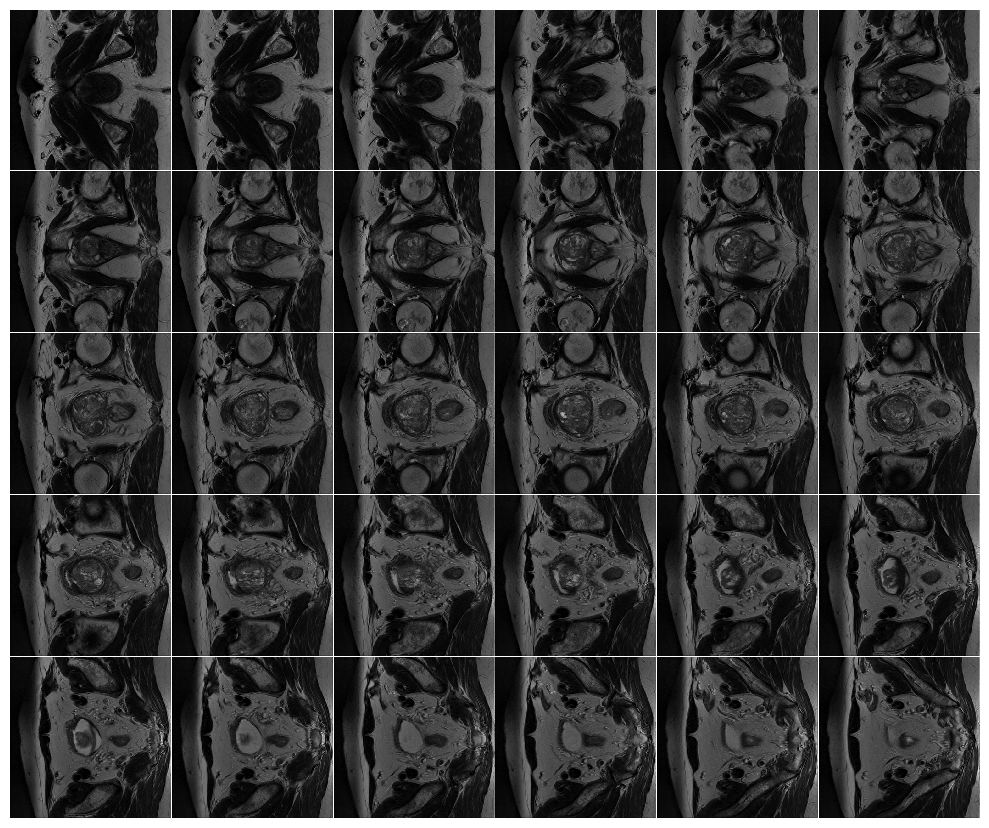

In [24]:
monai.visualize.matshow3d(t2w_image, cmap="gray",channel_dim=0,frame_dim=-1,show=True)
plt.show()

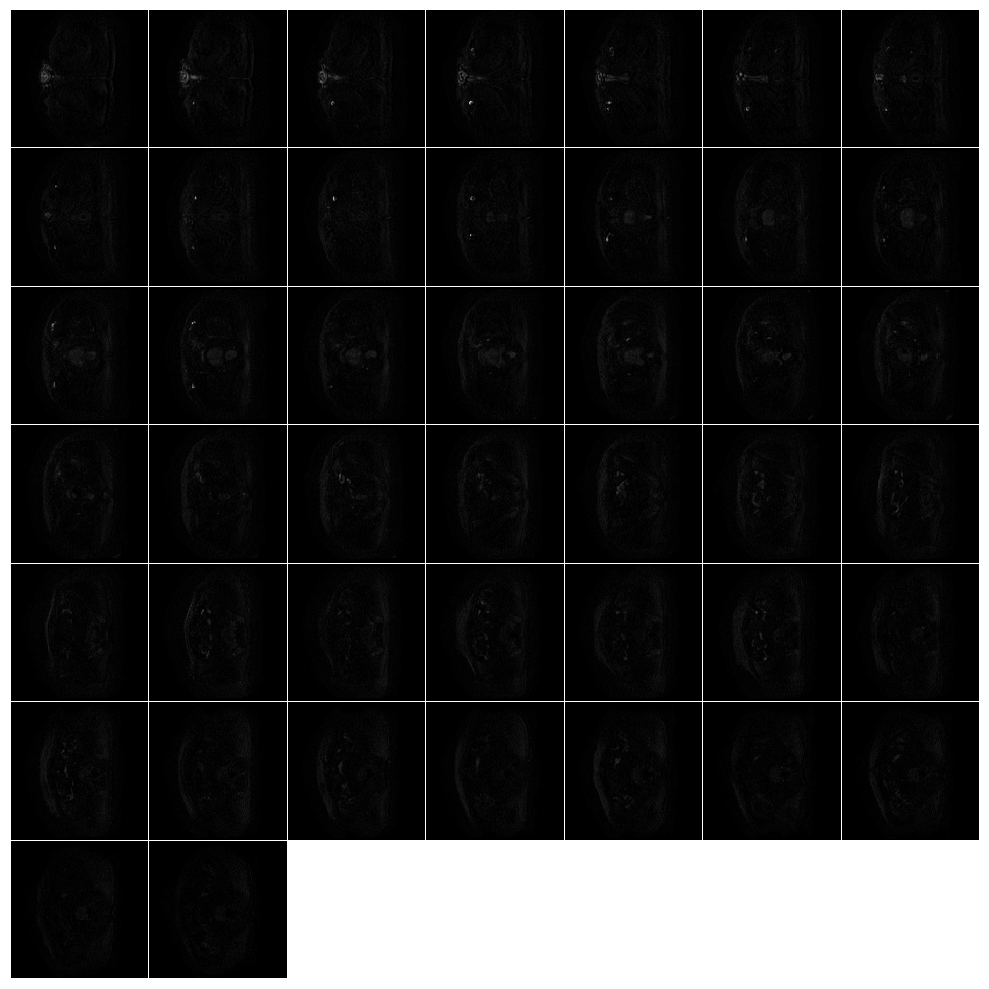

(<Figure size 1000x1000 with 1 Axes>,
 array([[[nan],
         [nan],
         [nan],
         ...,
         [nan],
         [nan],
         [nan]],
 
        [[nan],
         [ 0.],
         [ 0.],
         ...,
         [ 0.],
         [ 0.],
         [nan]],
 
        [[nan],
         [ 0.],
         [ 0.],
         ...,
         [ 0.],
         [ 0.],
         [nan]],
 
        ...,
 
        [[nan],
         [ 0.],
         [ 0.],
         ...,
         [nan],
         [nan],
         [nan]],
 
        [[nan],
         [ 0.],
         [ 0.],
         ...,
         [nan],
         [nan],
         [nan]],
 
        [[nan],
         [nan],
         [nan],
         ...,
         [nan],
         [nan],
         [nan]]], dtype=float32))

In [27]:
monai.visualize.matshow3d(dwi_image, cmap="gray",channel_dim=0,frame_dim=-1,show=True)

In [45]:
association_list=[]
for i,row in t2w_axial.iterrows():
    subject = row['subject']
    session = row['session']

    sub_dwi_df = dwi_df[(dwi_df['subject'] == subject) & (dwi_df['session'] == session)].reset_index(drop=True)
    sub_adc_df = adc_df[(adc_df['subject'] == subject) & (adc_df['session'] == session)].reset_index(drop=True)
    association_list.append({'subject': subject, 'session': session, 'image_t2': row['image']})
    if not sub_dwi_df.empty:
        
        times=[]

        #adquisition_time_t2 = datetime.combine(datetime.min, row['AcquisitionTime'])
        t2w_image_path = os.path.join(path, t2w_df.subject[index], t2w_df.session[index],'mim-mr','anat', t2w_df.image[index])
        t2w_image = monai.transforms.LoadImage(ensure_channel_first=True)(t2w_image_path)
        #print(t2w_image.shape)
        image_t2_slices = t2w_image.shape[-1]
        images_dwi_dict ={}
        for i, dwi_row in sub_dwi_df.iterrows():
            dwi_image_path = os.path.join(path, dwi_row['subject'], dwi_row['session'],'mim-mr','dwi', dwi_row['image'])
            dwi_image = monai.transforms.LoadImage(ensure_channel_first=True)(dwi_image_path)
            #print(dwi_image.shape)
            image_dwi_slices = dwi_image.shape[-1]
            #adquisition_time_dwi = datetime.combine(datetime.min, dwi_row['AcquisitionTime'])
            #if abs(image_t2_slices - image_dwi_slices)<5:
                #times.append(abs(adquisition_time_t2-adquisition_time_dwi).total_seconds())
            bvalue = max(dwi_protocols[dwi_row['protocol_association']])
            images_dwi_dict.update({f'image_dwi_b{bvalue}': dwi_row['image']})


        #if times:
        association_list[-1].update(images_dwi_dict)
    
    if not sub_adc_df.empty:
        images_adc_dict ={}
        for i, adc_row in sub_adc_df.iterrows():

            if 'derivative' in adc_row['modality']:

                adc_image_path = os.path.join(derivatives_path, adc_row['subject'], adc_row['session'],'mim-mr','dwi', adc_row['image'])
                adc_image = monai.transforms.LoadImage(ensure_channel_first=True)(adc_image_path)
                image_adc_slices = adc_image.shape[-1]
                #adquisition_time_adc = datetime.combine(datetime.min, adc_row['AcquisitionTime'])
                if abs(image_t2_slices - image_adc_slices)<5:
                    bvalue = max(adc_row['bvalues']) if isinstance(adc_row['bvalues'],list) else 0
                    images_adc_dict.update({f'image_adc_b{bvalue}': adc_row['image'], f'adc_b{bvalue}_derivative': True})
            else:
                adc_image_path = os.path.join(path, adc_row['subject'], adc_row['session'],'mim-mr','dwi', adc_row['image'])
                adc_image = monai.transforms.LoadImage(ensure_channel_first=True)(adc_image_path)
                image_adc_slices = adc_image.shape[-1]
                #adquisition_time_adc = datetime.combine(datetime.min, adc_row['AcquisitionTime'])
                #if abs(image_t2_slices - image_adc_slices)<5:
                bvalue = max(adc_row['bvalues']) if isinstance(adc_row['bvalues'],list) else 0
                images_adc_dict.update({f'image_adc_b{bvalue}': adc_row['image'], f'adc_b{bvalue}_derivative': False})

        association_list[-1].update(images_adc_dict)

    # if i==3:
    #     break

association_df = pd.DataFrame(association_list)
association_df = association_df.sort_index(axis=1,ascending=False)

In [76]:
sub_adc_df

,subject,session,image,modality,AccessionNumber,AcquisitionDate,AcquisitionMatrix,AcquisitionNumber,AcquisitionTime,AngioFlag,...,RedPaletteColorLookupTableDescriptor,ContrastBolusIngredient,ContrastBolusIngredientConcentration,ContrastBolusVolume,PatientOrientation,AcquisitionDateTime,BurnedInAnnotation,ContentQualification,PatientIdentityRemoved,PatientSize
0,sub-003671,ses-006159,sub-003671_ses-006159_acq-adc_run-653_bp-prost...,adc,006159,20131202,"[180, 0, 0, 90]",1.0,085541,N,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,sub-003671,ses-006159,sub-003671_ses-006159_acq-adc_run-950_bp-prost...,adc,006159,20131202,"[180, 0, 0, 90]",1.0,085541,N,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,sub-003671,ses-006159,sub-003671_ses-006159_acq-adc_run-350_bp-prost...,adc,006159,20131202,"[128, 0, 0, 128]",1.0,082140,N,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,sub-003671,ses-006159,sub-003671_ses-006159_acq-bvalue_run-3_bp-pros...,derivative/adc,006159,20131202,"[128, 0, 0, 128]",NaN,082140,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [46]:
association_df

,subject,session,image_t2,image_dwi_b800,image_dwi_b600,image_dwi_b2000,image_dwi_b1800,image_dwi_b1500,image_dwi_b1400,image_dwi_b1000,...,image_adc_b1000,image_adc_b0,adc_b800_derivative,adc_b600_derivative,adc_b2000_derivative,adc_b1800_derivative,adc_b1500_derivative,adc_b1400_derivative,adc_b1000_derivative,adc_b0_derivative
0,sub-003629,ses-003863,sub-003629_ses-003863_acq-fse_run-801_bp-prost...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,sub-003629_ses-003863_acq-adc_run-703_bp-prost...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
1,sub-003629,ses-003863,sub-003629_ses-003863_acq-fse_run-601_bp-prost...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,sub-003629_ses-003863_acq-adc_run-703_bp-prost...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
2,sub-005730,ses-006206,sub-005730_ses-006206_acq-fse_run-6_bp-prostat...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,sub-005730_ses-006206_acq-adc_run-850_bp-prost...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
3,sub-005730,ses-006206,sub-005730_ses-006206_acq-fse_run-9_bp-prostat...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,sub-005730_ses-006206_acq-adc_run-850_bp-prost...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
4,sub-007667,ses-008463,sub-007667_ses-008463_acq-fse_run-1001_bp-pros...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,sub-007667_ses-008463_acq-adc_run-903_bp-prost...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14503,sub-002491,ses-002679,sub-002491_ses-002679_acq-fse_run-4_bp-prostat...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
14504,sub-003671,ses-003908,sub-003671_ses-003908_acq-propeller_run-6_bp-p...,sub-003671_ses-003908_acq-bvalue_run-3_bp-pros...,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,sub-003671_ses-003908_acq-adc_run-750_bp-prost...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
14505,sub-003671,ses-003908,sub-003671_ses-003908_acq-fse_run-4_bp-prostat...,sub-003671_ses-003908_acq-bvalue_run-3_bp-pros...,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,sub-003671_ses-003908_acq-adc_run-750_bp-prost...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
14506,sub-003671,ses-006159,sub-003671_ses-006159_acq-fse_run-6_bp-prostat...,sub-003671_ses-006159_acq-bvalue_run-3_bp-pros...,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,sub-003671_ses-006159_acq-adc_run-350_bp-prost...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False


In [47]:
adc_row = association_df[association_df.image_adc_b0.isnull() == False].reset_index(drop=True).iloc[0]
adc_image_path = os.path.join(path, adc_row['subject'], adc_row['session'],'mim-mr','dwi', adc_row['image_adc_b0'])


In [48]:
association_df[association_df.image_adc_b0.isnull() == False]

,subject,session,image_t2,image_dwi_b800,image_dwi_b600,image_dwi_b2000,image_dwi_b1800,image_dwi_b1500,image_dwi_b1400,image_dwi_b1000,...,image_adc_b1000,image_adc_b0,adc_b800_derivative,adc_b600_derivative,adc_b2000_derivative,adc_b1800_derivative,adc_b1500_derivative,adc_b1400_derivative,adc_b1000_derivative,adc_b0_derivative
0,sub-003629,ses-003863,sub-003629_ses-003863_acq-fse_run-801_bp-prost...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,sub-003629_ses-003863_acq-adc_run-703_bp-prost...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
1,sub-003629,ses-003863,sub-003629_ses-003863_acq-fse_run-601_bp-prost...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,sub-003629_ses-003863_acq-adc_run-703_bp-prost...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
2,sub-005730,ses-006206,sub-005730_ses-006206_acq-fse_run-6_bp-prostat...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,sub-005730_ses-006206_acq-adc_run-850_bp-prost...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
3,sub-005730,ses-006206,sub-005730_ses-006206_acq-fse_run-9_bp-prostat...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,sub-005730_ses-006206_acq-adc_run-850_bp-prost...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
4,sub-007667,ses-008463,sub-007667_ses-008463_acq-fse_run-1001_bp-pros...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,sub-007667_ses-008463_acq-adc_run-903_bp-prost...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14502,sub-003843,ses-004092,sub-003843_ses-004092_acq-fse_run-1001_bp-pros...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,sub-003843_ses-004092_acq-adc_run-903_bp-prost...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
14504,sub-003671,ses-003908,sub-003671_ses-003908_acq-propeller_run-6_bp-p...,sub-003671_ses-003908_acq-bvalue_run-3_bp-pros...,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,sub-003671_ses-003908_acq-adc_run-750_bp-prost...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
14505,sub-003671,ses-003908,sub-003671_ses-003908_acq-fse_run-4_bp-prostat...,sub-003671_ses-003908_acq-bvalue_run-3_bp-pros...,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,sub-003671_ses-003908_acq-adc_run-750_bp-prost...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
14506,sub-003671,ses-006159,sub-003671_ses-006159_acq-fse_run-6_bp-prostat...,sub-003671_ses-006159_acq-bvalue_run-3_bp-pros...,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,sub-003671_ses-006159_acq-adc_run-350_bp-prost...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False


In [49]:
association_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14508 entries, 0 to 14507
Data columns (total 26 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   subject               14508 non-null  object
 1   session               14508 non-null  object
 2   image_t2              14508 non-null  object
 3   image_dwi_b800        3558 non-null   object
 4   image_dwi_b600        71 non-null     object
 5   image_dwi_b2000       1504 non-null   object
 6   image_dwi_b1800       21 non-null     object
 7   image_dwi_b1500       2263 non-null   object
 8   image_dwi_b1400       4 non-null      object
 9   image_dwi_b1000       1274 non-null   object
 10  image_adc_b800        424 non-null    object
 11  image_adc_b600        14 non-null     object
 12  image_adc_b2000       134 non-null    object
 13  image_adc_b1800       7 non-null      object
 14  image_adc_b1500       619 non-null    object
 15  image_adc_b1400       4 non-null    

## Add Clinical Variables

In [51]:
df = pd.read_csv('Prostate_Cancer_TFM/Files/Own_data/Clinical_Variables.tsv',sep='\t')
training = df[df['project']=='p0052021']
training['subject_mids'] = training['label_subject'].apply(lambda x: f"sub-{x:06d}")
training['session_mids'] = training['label_session'].apply(lambda x: f"ses-{x:06d}")


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [52]:
training

,project,dep,CRC,label_subject,label_session,ED,AF,TB,TR,PSA,...,PIR,csPC,F_nacimiento,F_RM,F_TACTO_RECTAL,F_PSA,F_csPC,Time_diff_TB,subject_mids,session_mids
192,p0052021,5.0,977.0,5652,6114,61.0,NaN,NaN,NaN,4.12,...,2.0,0.0,1958-10-14,2019-11-01,NaN,2019-10-14,2019-12-15,NaN,sub-005652,ses-006114
193,p0052021,18.0,1215.0,5405,5830,62.0,NaN,3.0,NaN,NaN,...,NaN,0.0,1949-10-08,2014-09-24,NaN,NaN,2017-06-20,2011-12-14,sub-005405,ses-005830
194,p0052021,19.0,1200.0,5894,6388,38.0,NaN,NaN,NaN,NaN,...,NaN,0.0,1974-11-05,2013-04-09,NaN,NaN,2013-03-02,NaN,sub-005894,ses-006388
195,p0052021,5.0,977.0,5400,5821,59.0,NaN,NaN,NaN,9.11,...,NaN,0.0,1953-05-14,2012-06-24,NaN,2012-05-14,2010-05-26,NaN,sub-005400,ses-005821
196,p0052021,15.0,1207.0,5401,5824,64.0,NaN,2.0,NaN,NaN,...,3.0,0.0,1957-03-29,2018-12-19,NaN,NaN,2021-09-11,2021-12-13,sub-005401,ses-005824
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10304,p0052021,17.0,1234.0,5390,5809,75.0,NaN,2.0,NaN,0.36,...,NaN,1.0,1939-06-23,2013-05-27,NaN,2013-05-06,2013-07-21,2015-04-27,sub-005390,ses-005809
10305,p0052021,5.0,977.0,5391,5810,62.0,NaN,NaN,NaN,7.96,...,NaN,1.0,1952-01-11,2014-05-15,NaN,2013-11-28,2014-08-31,NaN,sub-005391,ses-005810
10306,p0052021,5.0,977.0,5392,5811,71.0,NaN,NaN,NaN,6.29,...,NaN,0.0,1941-08-31,2012-10-24,NaN,2012-04-07,2012-12-29,NaN,sub-005392,ses-005811
10307,p0052021,4.0,974.0,5393,5812,54.0,NaN,NaN,NaN,NaN,...,3.0,0.0,1957-12-12,2011-12-13,NaN,NaN,2013-04-02,NaN,sub-005393,ses-005812


In [53]:
# Merge dataframes on specified columns
complete_df = pd.merge(association_df, training, right_on=['subject_mids', 'session_mids'], left_on=['subject', 'session'])

# Drop specified columns
columns_to_drop = ['label_subject', 'label_session', 'Time_diff_TB', 'subject_mids', 'session_mids', 'project', 'CRC','F_TACTO_RECTAL','F_PSA','F_csPC']
complete_df = complete_df.drop(columns=columns_to_drop)

In [54]:
complete_df

,subject,session,image_t2,image_dwi_b800,image_dwi_b600,image_dwi_b2000,image_dwi_b1800,image_dwi_b1500,image_dwi_b1400,image_dwi_b1000,...,ED,AF,TB,TR,PSA,VP,PIR,csPC,F_nacimiento,F_RM
0,sub-003629,ses-003863,sub-003629_ses-003863_acq-fse_run-801_bp-prost...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,56.0,NaN,NaN,NaN,5.19,98.0000,2.0,NaN,1962-07-15,2019-04-29
1,sub-003629,ses-003863,sub-003629_ses-003863_acq-fse_run-601_bp-prost...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,56.0,NaN,NaN,NaN,5.19,98.0000,2.0,NaN,1962-07-15,2019-04-29
2,sub-005730,ses-006206,sub-005730_ses-006206_acq-fse_run-6_bp-prostat...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,69.0,NaN,NaN,NaN,11.16,NaN,NaN,0.0,1946-10-10,2016-01-29
3,sub-005730,ses-006206,sub-005730_ses-006206_acq-fse_run-9_bp-prostat...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,69.0,NaN,NaN,NaN,11.16,NaN,NaN,0.0,1946-10-10,2016-01-29
4,sub-007667,ses-008463,sub-007667_ses-008463_acq-fse_run-1001_bp-pros...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,66.0,NaN,NaN,NaN,18.90,8999.2968,NaN,1.0,1949-12-30,2016-04-06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14499,sub-002491,ses-002679,sub-002491_ses-002679_acq-fse_run-4_bp-prostat...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,73.0,NaN,NaN,NaN,18.27,NaN,NaN,1.0,1934-07-30,2007-09-30
14500,sub-003671,ses-003908,sub-003671_ses-003908_acq-propeller_run-6_bp-p...,sub-003671_ses-003908_acq-bvalue_run-3_bp-pros...,NaN,NaN,NaN,NaN,NaN,NaN,...,64.0,NaN,NaN,NaN,7.48,89.0000,3.0,0.0,1950-10-29,2015-03-17
14501,sub-003671,ses-003908,sub-003671_ses-003908_acq-fse_run-4_bp-prostat...,sub-003671_ses-003908_acq-bvalue_run-3_bp-pros...,NaN,NaN,NaN,NaN,NaN,NaN,...,64.0,NaN,NaN,NaN,7.48,89.0000,3.0,0.0,1950-10-29,2015-03-17
14502,sub-003671,ses-006159,sub-003671_ses-006159_acq-fse_run-6_bp-prostat...,sub-003671_ses-006159_acq-bvalue_run-3_bp-pros...,NaN,NaN,NaN,NaN,NaN,NaN,...,63.0,NaN,NaN,NaN,7.22,84.6846,4.0,0.0,1950-10-29,2013-12-02


In [55]:
complete_df.columns

Index(['subject', 'session', 'image_t2', 'image_dwi_b800', 'image_dwi_b600',
       'image_dwi_b2000', 'image_dwi_b1800', 'image_dwi_b1500',
       'image_dwi_b1400', 'image_dwi_b1000', 'image_adc_b800',
       'image_adc_b600', 'image_adc_b2000', 'image_adc_b1800',
       'image_adc_b1500', 'image_adc_b1400', 'image_adc_b1000', 'image_adc_b0',
       'adc_b800_derivative', 'adc_b600_derivative', 'adc_b2000_derivative',
       'adc_b1800_derivative', 'adc_b1500_derivative', 'adc_b1400_derivative',
       'adc_b1000_derivative', 'adc_b0_derivative', 'dep', 'ED', 'AF', 'TB',
       'TR', 'PSA', 'VP', 'PIR', 'csPC', 'F_nacimiento', 'F_RM'],
      dtype='object')

In [84]:
complete_df.loc[~complete_df["image_adc_b0"].isna()]

,subject,session,image_t2,image_dwi_b800,image_dwi_b600,image_dwi_b2000,image_dwi_b1800,image_dwi_b1500,image_dwi_b1400,image_dwi_b1000,...,ED,AF,TB,TR,PSA,VP,PIR,csPC,F_nacimiento,F_RM
0,sub-003629,ses-003863,sub-003629_ses-003863_acq-fse_run-801_bp-prost...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,56.0,NaN,NaN,NaN,5.19,98.0000,2.0,NaN,1962-07-15,2019-04-29
1,sub-003629,ses-003863,sub-003629_ses-003863_acq-fse_run-601_bp-prost...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,56.0,NaN,NaN,NaN,5.19,98.0000,2.0,NaN,1962-07-15,2019-04-29
2,sub-005730,ses-006206,sub-005730_ses-006206_acq-fse_run-6_bp-prostat...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,69.0,NaN,NaN,NaN,11.16,NaN,NaN,0.0,1946-10-10,2016-01-29
3,sub-005730,ses-006206,sub-005730_ses-006206_acq-fse_run-9_bp-prostat...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,69.0,NaN,NaN,NaN,11.16,NaN,NaN,0.0,1946-10-10,2016-01-29
4,sub-007667,ses-008463,sub-007667_ses-008463_acq-fse_run-1001_bp-pros...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,66.0,NaN,NaN,NaN,18.90,8999.2968,NaN,1.0,1949-12-30,2016-04-06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14498,sub-003843,ses-004092,sub-003843_ses-004092_acq-fse_run-1001_bp-pros...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,75.0,NaN,NaN,NaN,2.14,17.0000,NaN,1.0,1940-06-12,2015-08-16
14500,sub-003671,ses-003908,sub-003671_ses-003908_acq-propeller_run-6_bp-p...,sub-003671_ses-003908_acq-bvalue_run-3_bp-pros...,NaN,NaN,NaN,NaN,NaN,NaN,...,64.0,NaN,NaN,NaN,7.48,89.0000,3.0,0.0,1950-10-29,2015-03-17
14501,sub-003671,ses-003908,sub-003671_ses-003908_acq-fse_run-4_bp-prostat...,sub-003671_ses-003908_acq-bvalue_run-3_bp-pros...,NaN,NaN,NaN,NaN,NaN,NaN,...,64.0,NaN,NaN,NaN,7.48,89.0000,3.0,0.0,1950-10-29,2015-03-17
14502,sub-003671,ses-006159,sub-003671_ses-006159_acq-fse_run-6_bp-prostat...,sub-003671_ses-006159_acq-bvalue_run-3_bp-pros...,NaN,NaN,NaN,NaN,NaN,NaN,...,63.0,NaN,NaN,NaN,7.22,84.6846,4.0,0.0,1950-10-29,2013-12-02


In [87]:
complete_df.loc[~complete_df["image_adc_b0"].isna()][['subject', 'session', 'image_t2', 'image_dwi_b800', 'image_dwi_b600',
       'image_dwi_b2000', 'image_dwi_b1800', 'image_dwi_b1500',
       'image_dwi_b1400', 'image_dwi_b1000',
       'image_adc_b2000', 'image_adc_b1500', 'image_adc_b1000', 'image_adc_b0']].isna().sum()

subject               0
session               0
image_t2              0
image_dwi_b800     5506
image_dwi_b600     8015
image_dwi_b2000    7632
image_dwi_b1800    8069
image_dwi_b1500    7699
image_dwi_b1400    8065
image_dwi_b1000    7972
image_adc_b2000    7972
image_adc_b1500    8051
image_adc_b1000    8065
image_adc_b0          0
dtype: int64

## Check Images Associated

In [57]:
img_columns = ['t2','dwi','adc']

transforms = monai.transforms.Compose([
    monai.transforms.LoadImaged(keys=img_columns, image_only=True,ensure_channel_first=True),
    monai.transforms.DataStatsd(keys=img_columns,),
    monai.transforms.ResampleToMatchd(
        keys=["adc", "dwi"],
        key_dst="t2",
        mode=("bilinear", "bilinear"),
    ),
    monai.transforms.SplitDimd(
        keys=["dwi"],
        keepdim=True,
    ),
    # Resample images to t2 dimension
    # monai.transforms.Resized(
    #     keys=img_columns,
    #     spatial_size=eval(input_shape),
    #     mode=("trilinear", "trilinear", "trilinear", "nearest"),
    # ),  # SAMUNETR: Reshape to have the same dimension
    monai.transforms.ScaleIntensityd(keys=['t2','dwi_0','dwi_1','adc'], minv=0.0, maxv=1.0, allow_missing_keys=True),
    # monai.transforms.NormalizeIntensityd(keys=img_columns),
    monai.transforms.ConcatItemsd(keys=['t2','dwi_0','adc'], name="image", dim=0),
])

In [60]:
index=14500
images_dict = {
    't2': os.path.join(path,complete_df.subject[index], complete_df.session[index],'mim-mr','anat', complete_df.image_t2[index]),
    'dwi': os.path.join(path,complete_df.subject[index], complete_df.session[index],'mim-mr','dwi', complete_df.image_dwi_b800[index]),
    'adc': os.path.join(derivatives_path,complete_df.subject[index], complete_df.session[index],'mim-mr','dwi', complete_df.image_adc_b0[index]) if complete_df.adc_b0_derivative[index] else os.path.join(path,complete_df.subject[index], complete_df.session[index],'mim-mr','dwi', complete_df.image_adc_b0[index])
    }

In [61]:
images = transforms(images_dict)

Data statistics:
Type: <class 'monai.data.meta_tensor.MetaTensor'> torch.float32
Shape: torch.Size([1, 512, 512, 30])
Value range: (0.0, 7565.0)
Data statistics:
Type: <class 'monai.data.meta_tensor.MetaTensor'> torch.float32
Shape: torch.Size([2, 256, 256, 44])
Value range: (0.0, 5212.0)
Data statistics:
Type: <class 'monai.data.meta_tensor.MetaTensor'> torch.float32
Shape: torch.Size([1, 256, 256, 30])
Value range: (-1.0, 4094.0)


In [62]:
print("T2w shape: ", images['t2'].shape)
print("DWI shape: ", images['dwi_0'].shape)
print("ADC shape: ", images['adc'].shape)
print("Concat shape: ", images['image'].shape)

T2w shape:  torch.Size([1, 512, 512, 30])
DWI shape:  torch.Size([1, 512, 512, 30])
ADC shape:  torch.Size([1, 512, 512, 30])
Concat shape:  torch.Size([3, 512, 512, 30])


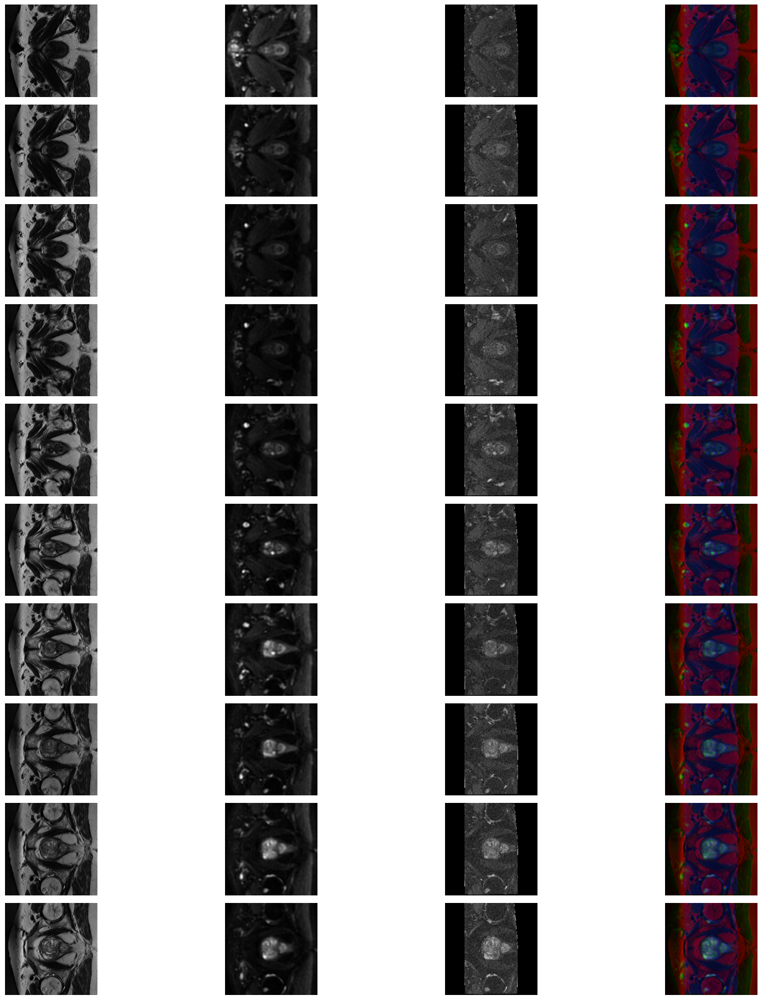

In [63]:
n_rows = 10
fig, axs = plt.subplots(n_rows, 4, figsize=(20,20))
for i in range(n_rows):
    axs[i,0].imshow(images['t2'][0,:,:,i], cmap='gray')
    axs[i,0].axis("off")
    axs[i,1].imshow(images['dwi_0'][0,:,:,i], cmap='gray')
    axs[i,1].axis("off")
    axs[i,2].imshow(images['adc'][0,:,:,i], cmap='gray')
    axs[i,2].axis("off")
    axs[i,3].imshow(images['image'][:,:,:,i].permute(1,2,0), cmap='gray')
    axs[i,3].axis("off")
fig.subplots_adjust(wspace=0, hspace=0)
plt.tight_layout()
plt.show()

In [64]:
complete_df.to_csv('Prostate_Cancer_TFM/Files/Own_data/Associated_Images_Training.csv',index=False)

## Divide tables for training

In [65]:
complete_df = pd.read_csv("Prostate_Cancer_TFM/Files/Own_data/Associated_Images_Training.csv")
complete_df

,subject,session,image_t2,image_dwi_b800,image_dwi_b600,image_dwi_b2000,image_dwi_b1800,image_dwi_b1500,image_dwi_b1400,image_dwi_b1000,...,ED,AF,TB,TR,PSA,VP,PIR,csPC,F_nacimiento,F_RM
0,sub-003629,ses-003863,sub-003629_ses-003863_acq-fse_run-801_bp-prost...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,56.0,NaN,NaN,NaN,5.19,98.0000,2.0,NaN,1962-07-15,2019-04-29
1,sub-003629,ses-003863,sub-003629_ses-003863_acq-fse_run-601_bp-prost...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,56.0,NaN,NaN,NaN,5.19,98.0000,2.0,NaN,1962-07-15,2019-04-29
2,sub-005730,ses-006206,sub-005730_ses-006206_acq-fse_run-6_bp-prostat...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,69.0,NaN,NaN,NaN,11.16,NaN,NaN,0.0,1946-10-10,2016-01-29
3,sub-005730,ses-006206,sub-005730_ses-006206_acq-fse_run-9_bp-prostat...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,69.0,NaN,NaN,NaN,11.16,NaN,NaN,0.0,1946-10-10,2016-01-29
4,sub-007667,ses-008463,sub-007667_ses-008463_acq-fse_run-1001_bp-pros...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,66.0,NaN,NaN,NaN,18.90,8999.2968,NaN,1.0,1949-12-30,2016-04-06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14499,sub-002491,ses-002679,sub-002491_ses-002679_acq-fse_run-4_bp-prostat...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,73.0,NaN,NaN,NaN,18.27,NaN,NaN,1.0,1934-07-30,2007-09-30
14500,sub-003671,ses-003908,sub-003671_ses-003908_acq-propeller_run-6_bp-p...,sub-003671_ses-003908_acq-bvalue_run-3_bp-pros...,NaN,NaN,NaN,NaN,NaN,NaN,...,64.0,NaN,NaN,NaN,7.48,89.0000,3.0,0.0,1950-10-29,2015-03-17
14501,sub-003671,ses-003908,sub-003671_ses-003908_acq-fse_run-4_bp-prostat...,sub-003671_ses-003908_acq-bvalue_run-3_bp-pros...,NaN,NaN,NaN,NaN,NaN,NaN,...,64.0,NaN,NaN,NaN,7.48,89.0000,3.0,0.0,1950-10-29,2015-03-17
14502,sub-003671,ses-006159,sub-003671_ses-006159_acq-fse_run-6_bp-prostat...,sub-003671_ses-006159_acq-bvalue_run-3_bp-pros...,NaN,NaN,NaN,NaN,NaN,NaN,...,63.0,NaN,NaN,NaN,7.22,84.6846,4.0,0.0,1950-10-29,2013-12-02


In [66]:
complete_df.columns

Index(['subject', 'session', 'image_t2', 'image_dwi_b800', 'image_dwi_b600',
       'image_dwi_b2000', 'image_dwi_b1800', 'image_dwi_b1500',
       'image_dwi_b1400', 'image_dwi_b1000', 'image_adc_b800',
       'image_adc_b600', 'image_adc_b2000', 'image_adc_b1800',
       'image_adc_b1500', 'image_adc_b1400', 'image_adc_b1000', 'image_adc_b0',
       'adc_b800_derivative', 'adc_b600_derivative', 'adc_b2000_derivative',
       'adc_b1800_derivative', 'adc_b1500_derivative', 'adc_b1400_derivative',
       'adc_b1000_derivative', 'adc_b0_derivative', 'dep', 'ED', 'AF', 'TB',
       'TR', 'PSA', 'VP', 'PIR', 'csPC', 'F_nacimiento', 'F_RM'],
      dtype='object')

In [78]:
dwib600_adcb600 = complete_df[['subject', 'session', 'image_t2', 'image_dwi_b600', 'image_adc_b600', 'dep', 'ED', 'AF', 'TB', 'TR', 'PSA', 'VP', 'PIR','csPC', 'F_nacimiento', 'F_RM']].copy()
dwib600_adcb600.dropna(subset=['image_dwi_b600', 'image_adc_b600'],inplace=True)
dwib600_adcb600.rename(columns={'image_dwi_b600': 'image_dwi', 'image_adc_b600': 'image_adc'},inplace=True)
dwib600_adcb600

,subject,session,image_t2,image_dwi,image_adc,dep,ED,AF,TB,TR,PSA,VP,PIR,csPC,F_nacimiento,F_RM
2271,sub-001706,ses-001843,sub-001706_ses-001843_acq-fse_run-4_bp-prostat...,sub-001706_ses-001843_acq-bvalue_run-12_bp-pro...,sub-001706_ses-001843_acq-bvalue_run-12_bp-pro...,5.0,65.0,NaN,NaN,NaN,9.62,NaN,NaN,0.0,1941-12-28,2007-08-16
3306,sub-004166,ses-005215,sub-004166_ses-005215_acq-fse_run-4_bp-prostat...,sub-004166_ses-005215_acq-bvalue_run-12_bp-pro...,sub-004166_ses-005215_acq-bvalue_run-12_bp-pro...,5.0,54.0,NaN,NaN,NaN,4.29,NaN,NaN,1.0,1959-07-24,2013-07-27
4085,sub-001543,ses-001671,sub-001543_ses-001671_acq-fse_run-4_bp-prostat...,sub-001543_ses-001671_acq-bvalue_run-12_bp-pro...,sub-001543_ses-001671_acq-bvalue_run-13_bp-pro...,5.0,51.0,NaN,NaN,NaN,18.98,NaN,NaN,1.0,1956-09-07,2007-12-24
4201,sub-001542,ses-001670,sub-001542_ses-001670_acq-fse_run-4_bp-prostat...,sub-001542_ses-001670_acq-bvalue_run-8_bp-pros...,sub-001542_ses-001670_acq-bvalue_run-8_bp-pros...,5.0,78.0,NaN,NaN,NaN,0.43,NaN,NaN,0.0,1934-08-13,2012-12-18
4742,sub-001445,ses-001559,sub-001445_ses-001559_acq-fse_run-4_bp-prostat...,sub-001445_ses-001559_acq-bvalue_run-11_bp-pro...,sub-001445_ses-001559_acq-bvalue_run-11_bp-pro...,5.0,76.0,NaN,NaN,NaN,8.67,NaN,NaN,0.0,1932-03-25,2009-01-12
5128,sub-003860,ses-004109,sub-003860_ses-004109_acq-fse_run-12_bp-prosta...,sub-003860_ses-004109_acq-bvalue_run-11_bp-pro...,sub-003860_ses-004109_acq-bvalue_run-11_bp-pro...,4.0,73.0,NaN,NaN,NaN,NaN,26.208,NaN,1.0,1945-10-16,2019-05-31
5129,sub-003860,ses-004109,sub-003860_ses-004109_acq-fse_run-7_bp-prostat...,sub-003860_ses-004109_acq-bvalue_run-11_bp-pro...,sub-003860_ses-004109_acq-bvalue_run-11_bp-pro...,4.0,73.0,NaN,NaN,NaN,NaN,26.208,NaN,1.0,1945-10-16,2019-05-31
5130,sub-003860,ses-004109,sub-003860_ses-004109_acq-fse_run-3_bp-prostat...,sub-003860_ses-004109_acq-bvalue_run-11_bp-pro...,sub-003860_ses-004109_acq-bvalue_run-11_bp-pro...,4.0,73.0,NaN,NaN,NaN,NaN,26.208,NaN,1.0,1945-10-16,2019-05-31
6042,sub-001511,ses-001629,sub-001511_ses-001629_acq-fse_run-4_bp-prostat...,sub-001511_ses-001629_acq-bvalue_run-11_bp-pro...,sub-001511_ses-001629_acq-bvalue_run-11_bp-pro...,5.0,50.0,NaN,NaN,NaN,35.10,NaN,NaN,1.0,1961-05-07,2012-01-25
6642,sub-001538,ses-001664,sub-001538_ses-001664_acq-fse_run-4_bp-prostat...,sub-001538_ses-001664_acq-bvalue_run-12_bp-pro...,sub-001538_ses-001664_acq-bvalue_run-12_bp-pro...,5.0,62.0,NaN,NaN,NaN,4.94,NaN,NaN,1.0,1946-05-26,2009-02-07


In [77]:
dwib800_adcb800 = complete_df[['subject', 'session', 'image_t2', 'image_dwi_b800', 'image_adc_b800', 'dep', 'ED', 'AF', 'TB', 'TR', 'PSA', 'VP', 'PIR','csPC', 'F_nacimiento', 'F_RM']].copy()
dwib800_adcb800.dropna(subset=['image_dwi_b800', 'image_adc_b800'],inplace=True)
dwib800_adcb800.rename(columns={'image_dwi_b800': 'image_dwi', 'image_adc_b800': 'image_adc'},inplace=True)
dwib800_adcb800

,subject,session,image_t2,image_dwi,image_adc,dep,ED,AF,TB,TR,PSA,VP,PIR,csPC,F_nacimiento,F_RM
88,sub-007635,ses-008424,sub-007635_ses-008424_acq-propeller_run-700_bp...,sub-007635_ses-008424_acq-bvalue_run-5_bp-pros...,sub-007635_ses-008424_acq-bvalue_run-5_bp-pros...,17.0,68.0,NaN,1.0,NaN,8.02,24.19560,NaN,1.0,1944-09-16,2017-06-28
89,sub-007635,ses-008424,sub-007635_ses-008424_acq-propeller_run-4_bp-p...,sub-007635_ses-008424_acq-bvalue_run-5_bp-pros...,sub-007635_ses-008424_acq-bvalue_run-5_bp-pros...,17.0,68.0,NaN,1.0,NaN,8.02,24.19560,NaN,1.0,1944-09-16,2017-06-28
90,sub-007635,ses-008424,sub-007635_ses-008424_acq-propeller_run-7_bp-p...,sub-007635_ses-008424_acq-bvalue_run-5_bp-pros...,sub-007635_ses-008424_acq-bvalue_run-5_bp-pros...,17.0,68.0,NaN,1.0,NaN,8.02,24.19560,NaN,1.0,1944-09-16,2017-06-28
99,sub-005390,ses-007916,sub-005390_ses-007916_acq-propeller_run-8_bp-p...,sub-005390_ses-007916_acq-bvalue_run-6_bp-pros...,sub-005390_ses-007916_acq-bvalue_run-6_bp-pros...,17.0,75.0,NaN,2.0,NaN,7.29,NaN,NaN,1.0,1939-06-23,2012-06-23
100,sub-005390,ses-007916,sub-005390_ses-007916_acq-propeller_run-800_bp...,sub-005390_ses-007916_acq-bvalue_run-6_bp-pros...,sub-005390_ses-007916_acq-bvalue_run-6_bp-pros...,17.0,75.0,NaN,2.0,NaN,7.29,NaN,NaN,1.0,1939-06-23,2012-06-23
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14303,sub-001502,ses-001619,sub-001502_ses-001619_acq-propeller_run-6_bp-p...,sub-001502_ses-001619_acq-bvalue_run-8_bp-pros...,sub-001502_ses-001619_acq-bvalue_run-8_bp-pros...,17.0,68.0,NaN,1.0,NaN,12.17,7.99344,NaN,1.0,1946-05-23,2014-12-23
14304,sub-001502,ses-001619,sub-001502_ses-001619_acq-propeller_run-600_bp...,sub-001502_ses-001619_acq-bvalue_run-8_bp-pros...,sub-001502_ses-001619_acq-bvalue_run-8_bp-pros...,17.0,68.0,NaN,1.0,NaN,12.17,7.99344,NaN,1.0,1946-05-23,2014-12-23
14342,sub-001692,ses-001828,sub-001692_ses-001828_acq-propeller_run-600_bp...,sub-001692_ses-001828_acq-bvalue_run-7_bp-pros...,sub-001692_ses-001828_acq-bvalue_run-7_bp-pros...,17.0,63.0,NaN,1.0,NaN,15.56,34.58000,NaN,1.0,1947-09-01,2011-08-09
14343,sub-001692,ses-001828,sub-001692_ses-001828_acq-propeller_run-4_bp-p...,sub-001692_ses-001828_acq-bvalue_run-7_bp-pros...,sub-001692_ses-001828_acq-bvalue_run-7_bp-pros...,17.0,63.0,NaN,1.0,NaN,15.56,34.58000,NaN,1.0,1947-09-01,2011-08-09


In [80]:
dwib1400_adcb1400 = complete_df[['subject', 'session', 'image_t2', 'image_dwi_b1400', 'image_adc_b1400', 'dep', 'ED', 'AF', 'TB', 'TR', 'PSA', 'VP', 'PIR','csPC', 'F_nacimiento', 'F_RM']].copy()
dwib1400_adcb1400.dropna(subset=['image_dwi_b1400', 'image_adc_b1400'],inplace=True)
dwib1400_adcb1400.rename(columns={'image_dwi_b1400': 'image_dwi', 'image_adc_b1400': 'image_adc'},inplace=True)
dwib1400_adcb1400

,subject,session,image_t2,image_dwi,image_adc,dep,ED,AF,TB,TR,PSA,VP,PIR,csPC,F_nacimiento,F_RM
14283,sub-005403,ses-005828,sub-005403_ses-005828_acq-fse_run-5_bp-prostat...,sub-005403_ses-005828_acq-bvalue_run-13_bp-pro...,sub-005403_ses-005828_acq-bvalue_run-13_bp-pro...,17.0,39.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1978-05-13,2017-10-16
14284,sub-005403,ses-005828,sub-005403_ses-005828_acq-propeller_run-10_bp-...,sub-005403_ses-005828_acq-bvalue_run-13_bp-pro...,sub-005403_ses-005828_acq-bvalue_run-13_bp-pro...,17.0,39.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1978-05-13,2017-10-16
14285,sub-005403,ses-005828,sub-005403_ses-005828_acq-propeller_run-11_bp-...,sub-005403_ses-005828_acq-bvalue_run-13_bp-pro...,sub-005403_ses-005828_acq-bvalue_run-13_bp-pro...,17.0,39.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1978-05-13,2017-10-16
14286,sub-005403,ses-005828,sub-005403_ses-005828_acq-propeller_run-8_bp-p...,sub-005403_ses-005828_acq-bvalue_run-13_bp-pro...,sub-005403_ses-005828_acq-bvalue_run-13_bp-pro...,17.0,39.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1978-05-13,2017-10-16


In [69]:
dwib800_adcb0 = complete_df[['subject', 'session', 'image_t2', 'image_dwi_b800', 'image_adc_b0', 'dep', 'ED', 'AF', 'TB', 'TR', 'PSA', 'VP', 'PIR','csPC', 'F_nacimiento', 'F_RM']].copy()
dwib800_adcb0.dropna(subset=['image_dwi_b800', 'image_adc_b0'],inplace=True)
dwib800_adcb0.rename(columns={'image_dwi_b800': 'image_dwi', 'image_adc_b0': 'image_adc'},inplace=True)
dwib800_adcb0

,subject,session,image_t2,image_dwi,image_adc,dep,ED,AF,TB,TR,PSA,VP,PIR,csPC,F_nacimiento,F_RM
12,sub-002299,ses-002477,sub-002299_ses-002477_acq-propeller_run-600_bp...,sub-002299_ses-002477_acq-bvalue_run-7_bp-pros...,sub-002299_ses-002477_acq-adc_run-800_bp-prost...,17.0,82.0,NaN,2.0,NaN,32.490,NaN,NaN,1.0,1935-05-07,2013-05-25
13,sub-002299,ses-002477,sub-002299_ses-002477_acq-propeller_run-4_bp-p...,sub-002299_ses-002477_acq-bvalue_run-7_bp-pros...,sub-002299_ses-002477_acq-adc_run-800_bp-prost...,17.0,82.0,NaN,2.0,NaN,32.490,NaN,NaN,1.0,1935-05-07,2013-05-25
14,sub-002299,ses-002477,sub-002299_ses-002477_acq-propeller_run-6_bp-p...,sub-002299_ses-002477_acq-bvalue_run-7_bp-pros...,sub-002299_ses-002477_acq-adc_run-800_bp-prost...,17.0,82.0,NaN,2.0,NaN,32.490,NaN,NaN,1.0,1935-05-07,2013-05-25
15,sub-002299,ses-004352,sub-002299_ses-004352_acq-propeller_run-7_bp-p...,sub-002299_ses-004352_acq-bvalue_run-5_bp-pros...,sub-002299_ses-004352_acq-adc_run-801_bp-prost...,17.0,82.0,NaN,2.0,NaN,0.014,38.88404,NaN,1.0,1935-05-07,2014-12-25
16,sub-002299,ses-004352,sub-002299_ses-004352_acq-propeller_run-700_bp...,sub-002299_ses-004352_acq-bvalue_run-5_bp-pros...,sub-002299_ses-004352_acq-adc_run-801_bp-prost...,17.0,82.0,NaN,2.0,NaN,0.014,38.88404,NaN,1.0,1935-05-07,2014-12-25
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14477,sub-006300,ses-006847,sub-006300_ses-006847_acq-fse_run-3_bp-prostat...,sub-006300_ses-006847_acq-bvalue_run-2_bp-pros...,sub-006300_ses-006847_acq-adc_run-250_bp-prost...,5.0,48.0,NaN,NaN,NaN,8.420,31.00000,NaN,NaN,1965-10-12,2014-09-18
14500,sub-003671,ses-003908,sub-003671_ses-003908_acq-propeller_run-6_bp-p...,sub-003671_ses-003908_acq-bvalue_run-3_bp-pros...,sub-003671_ses-003908_acq-adc_run-750_bp-prost...,5.0,64.0,NaN,NaN,NaN,7.480,89.00000,3.0,0.0,1950-10-29,2015-03-17
14501,sub-003671,ses-003908,sub-003671_ses-003908_acq-fse_run-4_bp-prostat...,sub-003671_ses-003908_acq-bvalue_run-3_bp-pros...,sub-003671_ses-003908_acq-adc_run-750_bp-prost...,5.0,64.0,NaN,NaN,NaN,7.480,89.00000,3.0,0.0,1950-10-29,2015-03-17
14502,sub-003671,ses-006159,sub-003671_ses-006159_acq-fse_run-6_bp-prostat...,sub-003671_ses-006159_acq-bvalue_run-3_bp-pros...,sub-003671_ses-006159_acq-adc_run-350_bp-prost...,5.0,63.0,NaN,NaN,NaN,7.220,84.68460,4.0,0.0,1950-10-29,2013-12-02


In [70]:
dwib1000_adcb1000 = complete_df[['subject', 'session', 'image_t2', 'image_dwi_b1000', 'image_adc_b1000', 'dep', 'ED', 'AF', 'TB', 'TR', 'PSA', 'VP', 'PIR','csPC', 'F_nacimiento', 'F_RM']].copy()
dwib1000_adcb1000.dropna(subset=['image_dwi_b1000', 'image_adc_b1000'],inplace=True)
dwib1000_adcb1000.rename(columns={'image_dwi_b1000': 'image_dwi', 'image_adc_b1000': 'image_adc'},inplace=True)
dwib1000_adcb1000

,subject,session,image_t2,image_dwi,image_adc,dep,ED,AF,TB,TR,PSA,VP,PIR,csPC,F_nacimiento,F_RM
11,sub-003156,ses-003373,sub-003156_ses-003373_acq-fse_run-8_bp-prostat...,sub-003156_ses-003373_acq-bvalue_run-10_bp-pro...,sub-003156_ses-003373_acq-bvalue_run-10_bp-pro...,7.0,63.0,NaN,2.0,NaN,5.36,45.88272,4.0,1.0,1948-06-30,2011-10-24
68,sub-001967,ses-003075,sub-001967_ses-003075_acq-fse_run-6_bp-prostat...,sub-001967_ses-003075_acq-bvalue_run-7_bp-pros...,sub-001967_ses-003075_acq-bvalue_run-7_bp-pros...,7.0,76.0,NaN,NaN,NaN,11.20,23.02560,4.0,1.0,1942-05-15,2018-06-21
102,sub-005690,ses-006160,sub-005690_ses-006160_acq-fse_run-8_bp-prostat...,sub-005690_ses-006160_acq-bvalue_run-10_bp-pro...,sub-005690_ses-006160_acq-bvalue_run-10_bp-pro...,7.0,73.0,NaN,2.0,NaN,6.37,25.33440,4.0,1.0,1938-02-19,2011-03-26
142,sub-004558,ses-004880,sub-004558_ses-004880_acq-fse_run-8_bp-prostat...,sub-004558_ses-004880_acq-bvalue_run-10_bp-pro...,sub-004558_ses-004880_acq-bvalue_run-10_bp-pro...,7.0,55.0,NaN,NaN,NaN,NaN,NaN,4.0,1.0,1954-01-18,2009-03-26
171,sub-002549,ses-003916,sub-002549_ses-003916_acq-fse_run-5_bp-prostat...,sub-002549_ses-003916_acq-bvalue_run-7_bp-pros...,sub-002549_ses-003916_acq-bvalue_run-7_bp-pros...,7.0,65.0,NaN,NaN,NaN,NaN,NaN,5.0,1.0,1946-10-10,2011-11-12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14423,sub-008931,ses-009974,sub-008931_ses-009974_acq-fse_run-10_bp-prosta...,sub-008931_ses-009974_acq-bvalue_run-11_bp-pro...,sub-008931_ses-009974_acq-bvalue_run-11_bp-pro...,7.0,58.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1957-09-29,2016-03-10
14446,sub-003568,ses-003801,sub-003568_ses-003801_acq-fse_run-9_bp-prostat...,sub-003568_ses-003801_acq-bvalue_run-11_bp-pro...,sub-003568_ses-003801_acq-bvalue_run-11_bp-pro...,7.0,73.0,NaN,2.0,NaN,4.80,90.41760,5.0,0.0,1944-04-12,2017-04-09
14448,sub-000884,ses-000951,sub-000884_ses-000951_acq-fse_run-10_bp-prosta...,sub-000884_ses-000951_acq-bvalue_run-12_bp-pro...,sub-000884_ses-000951_acq-bvalue_run-12_bp-pro...,7.0,73.0,NaN,NaN,NaN,NaN,29.40000,5.0,1.0,1939-10-10,2013-05-04
14449,sub-000884,ses-000951,sub-000884_ses-000951_acq-fse_run-8_bp-prostat...,sub-000884_ses-000951_acq-bvalue_run-12_bp-pro...,sub-000884_ses-000951_acq-bvalue_run-12_bp-pro...,7.0,73.0,NaN,NaN,NaN,NaN,29.40000,5.0,1.0,1939-10-10,2013-05-04


In [71]:
dwib1500_adcb1500 = complete_df[['subject', 'session', 'image_t2', 'image_dwi_b1500', 'image_adc_b1500', 'dep', 'ED', 'AF', 'TB', 'TR', 'PSA', 'VP', 'PIR','csPC', 'F_nacimiento', 'F_RM']].copy()
dwib1500_adcb1500.dropna(subset=['image_dwi_b1500', 'image_adc_b1500'],inplace=True)
dwib1500_adcb1500.rename(columns={'image_dwi_b1500': 'image_dwi', 'image_adc_b1500': 'image_adc'},inplace=True)
dwib1500_adcb1500

,subject,session,image_t2,image_dwi,image_adc,dep,ED,AF,TB,TR,PSA,VP,PIR,csPC,F_nacimiento,F_RM
11,sub-003156,ses-003373,sub-003156_ses-003373_acq-fse_run-8_bp-prostat...,sub-003156_ses-003373_acq-bvalue_run-11_bp-pro...,sub-003156_ses-003373_acq-bvalue_run-11_bp-pro...,7.0,63.0,NaN,2.0,NaN,5.36,45.88272,4.0,1.0,1948-06-30,2011-10-24
68,sub-001967,ses-003075,sub-001967_ses-003075_acq-fse_run-6_bp-prostat...,sub-001967_ses-003075_acq-bvalue_run-8_bp-pros...,sub-001967_ses-003075_acq-bvalue_run-8_bp-pros...,7.0,76.0,NaN,NaN,NaN,11.20,23.02560,4.0,1.0,1942-05-15,2018-06-21
102,sub-005690,ses-006160,sub-005690_ses-006160_acq-fse_run-8_bp-prostat...,sub-005690_ses-006160_acq-bvalue_run-11_bp-pro...,sub-005690_ses-006160_acq-bvalue_run-11_bp-pro...,7.0,73.0,NaN,2.0,NaN,6.37,25.33440,4.0,1.0,1938-02-19,2011-03-26
142,sub-004558,ses-004880,sub-004558_ses-004880_acq-fse_run-8_bp-prostat...,sub-004558_ses-004880_acq-bvalue_run-11_bp-pro...,sub-004558_ses-004880_acq-bvalue_run-11_bp-pro...,7.0,55.0,NaN,NaN,NaN,NaN,NaN,4.0,1.0,1954-01-18,2009-03-26
171,sub-002549,ses-003916,sub-002549_ses-003916_acq-fse_run-5_bp-prostat...,sub-002549_ses-003916_acq-bvalue_run-8_bp-pros...,sub-002549_ses-003916_acq-bvalue_run-8_bp-pros...,7.0,65.0,NaN,NaN,NaN,NaN,NaN,5.0,1.0,1946-10-10,2011-11-12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14423,sub-008931,ses-009974,sub-008931_ses-009974_acq-fse_run-10_bp-prosta...,sub-008931_ses-009974_acq-bvalue_run-12_bp-pro...,sub-008931_ses-009974_acq-bvalue_run-12_bp-pro...,7.0,58.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1957-09-29,2016-03-10
14446,sub-003568,ses-003801,sub-003568_ses-003801_acq-fse_run-9_bp-prostat...,sub-003568_ses-003801_acq-bvalue_run-12_bp-pro...,sub-003568_ses-003801_acq-bvalue_run-12_bp-pro...,7.0,73.0,NaN,2.0,NaN,4.80,90.41760,5.0,0.0,1944-04-12,2017-04-09
14448,sub-000884,ses-000951,sub-000884_ses-000951_acq-fse_run-10_bp-prosta...,sub-000884_ses-000951_acq-bvalue_run-13_bp-pro...,sub-000884_ses-000951_acq-bvalue_run-13_bp-pro...,7.0,73.0,NaN,NaN,NaN,NaN,29.40000,5.0,1.0,1939-10-10,2013-05-04
14449,sub-000884,ses-000951,sub-000884_ses-000951_acq-fse_run-8_bp-prostat...,sub-000884_ses-000951_acq-bvalue_run-13_bp-pro...,sub-000884_ses-000951_acq-bvalue_run-13_bp-pro...,7.0,73.0,NaN,NaN,NaN,NaN,29.40000,5.0,1.0,1939-10-10,2013-05-04


In [79]:
dwib1800_adcb1800 = complete_df[['subject', 'session', 'image_t2', 'image_dwi_b1800', 'image_adc_b1800', 'dep', 'ED', 'AF', 'TB', 'TR', 'PSA', 'VP', 'PIR','csPC', 'F_nacimiento', 'F_RM']].copy()
dwib1800_adcb1800.dropna(subset=['image_dwi_b1800', 'image_adc_b1800'],inplace=True)
dwib1800_adcb1800.rename(columns={'image_dwi_b1800': 'image_dwi', 'image_adc_b1800': 'image_adc'},inplace=True)
dwib1800_adcb1800

,subject,session,image_t2,image_dwi,image_adc,dep,ED,AF,TB,TR,PSA,VP,PIR,csPC,F_nacimiento,F_RM
455,sub-003426,ses-003655,sub-003426_ses-003655_acq-fse_run-4_bp-prostat...,sub-003426_ses-003655_acq-bvalue_run-6_bp-pros...,sub-003426_ses-003655_acq-bvalue_run-6_bp-pros...,7.0,58.0,NaN,1.0,NaN,4.42,NaN,3.0,1.0,1955-11-09,2014-08-24
1424,sub-003291,ses-003513,sub-003291_ses-003513_acq-fse_run-8_bp-prostat...,sub-003291_ses-003513_acq-bvalue_run-10_bp-pro...,sub-003291_ses-003513_acq-bvalue_run-10_bp-pro...,7.0,72.0,NaN,NaN,NaN,4.14,76.0,1.0,0.0,1949-03-28,2021-04-15
1425,sub-003291,ses-003513,sub-003291_ses-003513_acq-fse_run-4_bp-prostat...,sub-003291_ses-003513_acq-bvalue_run-10_bp-pro...,sub-003291_ses-003513_acq-bvalue_run-10_bp-pro...,7.0,72.0,NaN,NaN,NaN,4.14,76.0,1.0,0.0,1949-03-28,2021-04-15
5456,sub-003470,ses-003700,sub-003470_ses-003700_acq-fse_run-5_bp-prostat...,sub-003470_ses-003700_acq-bvalue_run-7_bp-pros...,sub-003470_ses-003700_acq-bvalue_run-7_bp-pros...,7.0,55.0,NaN,NaN,NaN,NaN,75.0,1.0,1.0,1963-07-19,2018-07-24
7827,sub-003567,ses-003800,sub-003567_ses-003800_acq-fse_run-8_bp-prostat...,sub-003567_ses-003800_acq-bvalue_run-10_bp-pro...,sub-003567_ses-003800_acq-bvalue_run-10_bp-pro...,7.0,73.0,NaN,NaN,NaN,14.64,54.0,4.0,0.0,1944-11-08,2018-04-07
8111,sub-003311,ses-003534,sub-003311_ses-003534_acq-fse_run-4_bp-prostat...,sub-003311_ses-003534_acq-bvalue_run-6_bp-pros...,sub-003311_ses-003534_acq-bvalue_run-6_bp-pros...,7.0,64.0,NaN,1.0,NaN,5.10,53.0,3.0,0.0,1957-07-21,2021-04-14
13086,sub-003368,ses-003593,sub-003368_ses-003593_acq-fse_run-5_bp-prostat...,sub-003368_ses-003593_acq-bvalue_run-7_bp-pros...,sub-003368_ses-003593_acq-bvalue_run-7_bp-pros...,7.0,59.0,NaN,NaN,NaN,3.76,NaN,1.0,0.0,1956-06-10,2016-05-30


In [73]:
dwib2000_adcb2000 = complete_df[['subject', 'session', 'image_t2', 'image_dwi_b2000', 'image_adc_b2000', 'dep', 'ED', 'AF', 'TB', 'TR', 'PSA', 'VP', 'PIR','csPC', 'F_nacimiento', 'F_RM']].copy()
dwib2000_adcb2000.dropna(subset=['image_dwi_b2000', 'image_adc_b2000'],inplace=True)
dwib2000_adcb2000.rename(columns={'image_dwi_b2000': 'image_dwi', 'image_adc_b2000': 'image_adc'},inplace=True)
dwib2000_adcb2000

,subject,session,image_t2,image_dwi,image_adc,dep,ED,AF,TB,TR,PSA,VP,PIR,csPC,F_nacimiento,F_RM
974,sub-007419,ses-008165,sub-007419_ses-008165_acq-fse_run-12_bp-prosta...,sub-007419_ses-008165_acq-bvalue_run-13_bp-pro...,sub-007419_ses-008165_acq-bvalue_run-13_bp-pro...,19.0,72.0,NaN,NaN,NaN,6.75,NaN,NaN,1.0,1942-06-17,2015-02-08
975,sub-007419,ses-008165,sub-007419_ses-008165_acq-fse_run-17_bp-prosta...,sub-007419_ses-008165_acq-bvalue_run-13_bp-pro...,sub-007419_ses-008165_acq-bvalue_run-13_bp-pro...,19.0,72.0,NaN,NaN,NaN,6.75,NaN,NaN,1.0,1942-06-17,2015-02-08
976,sub-007419,ses-008165,sub-007419_ses-008165_acq-fse_run-9_bp-prostat...,sub-007419_ses-008165_acq-bvalue_run-13_bp-pro...,sub-007419_ses-008165_acq-bvalue_run-13_bp-pro...,19.0,72.0,NaN,NaN,NaN,6.75,NaN,NaN,1.0,1942-06-17,2015-02-08
977,sub-007419,ses-008165,sub-007419_ses-008165_acq-fse_run-7_bp-prostat...,sub-007419_ses-008165_acq-bvalue_run-13_bp-pro...,sub-007419_ses-008165_acq-bvalue_run-13_bp-pro...,19.0,72.0,NaN,NaN,NaN,6.75,NaN,NaN,1.0,1942-06-17,2015-02-08
1549,sub-002394,ses-002581,sub-002394_ses-002581_acq-propeller_run-4_bp-p...,sub-002394_ses-002581_acq-bvalue_run-10_bp-pro...,sub-002394_ses-002581_acq-bvalue_run-10_bp-pro...,17.0,75.0,NaN,NaN,NaN,18.60,NaN,NaN,1.0,1932-10-16,2008-04-20
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13904,sub-007060,ses-008081,sub-007060_ses-008081_acq-propeller_run-4_bp-p...,sub-007060_ses-008081_acq-bvalue_run-7_bp-pros...,sub-007060_ses-008081_acq-bvalue_run-7_bp-pros...,17.0,72.0,NaN,3.0,NaN,14.33,56.4512,NaN,1.0,1943-08-31,2015-11-12
13905,sub-007060,ses-008081,sub-007060_ses-008081_acq-propeller_run-500_bp...,sub-007060_ses-008081_acq-bvalue_run-7_bp-pros...,sub-007060_ses-008081_acq-bvalue_run-7_bp-pros...,17.0,72.0,NaN,3.0,NaN,14.33,56.4512,NaN,1.0,1943-08-31,2015-11-12
13906,sub-007060,ses-008081,sub-007060_ses-008081_acq-propeller_run-5_bp-p...,sub-007060_ses-008081_acq-bvalue_run-7_bp-pros...,sub-007060_ses-008081_acq-bvalue_run-7_bp-pros...,17.0,72.0,NaN,3.0,NaN,14.33,56.4512,NaN,1.0,1943-08-31,2015-11-12
14471,sub-001034,ses-001123,sub-001034_ses-001123_acq-propeller_run-4_bp-p...,sub-001034_ses-001123_acq-bvalue_run-7_bp-pros...,sub-001034_ses-001123_acq-bvalue_run-7_bp-pros...,17.0,68.0,11.0,1.0,NaN,12.90,28.1736,NaN,0.0,1945-04-19,2014-01-02


In [88]:
dwib600_adcb0 = complete_df[['subject', 'session', 'image_t2', 'image_dwi_b600', 'image_adc_b0', 'dep', 'ED', 'AF', 'TB', 'TR', 'PSA', 'VP', 'PIR','csPC', 'F_nacimiento', 'F_RM']].copy()
dwib600_adcb0.dropna(subset=['image_dwi_b600', 'image_adc_b0'],inplace=True)
dwib600_adcb0.rename(columns={'image_dwi_b600': 'image_dwi', 'image_adc_b0': 'image_adc'},inplace=True)
print(dwib600_adcb0.shape)


dwib1000_adcb0 = complete_df[['subject', 'session', 'image_t2', 'image_dwi_b1000', 'image_adc_b0', 'dep', 'ED', 'AF', 'TB', 'TR', 'PSA', 'VP', 'PIR','csPC', 'F_nacimiento', 'F_RM']].copy()
dwib1000_adcb0.dropna(subset=['image_dwi_b1000', 'image_adc_b0'],inplace=True)
dwib1000_adcb0.rename(columns={'image_dwi_b1000': 'image_dwi', 'image_adc_b0': 'image_adc'},inplace=True)
print(dwib1000_adcb0.shape)

dwib1400_adcb0 = complete_df[['subject', 'session', 'image_t2', 'image_dwi_b1400', 'image_adc_b0', 'dep', 'ED', 'AF', 'TB', 'TR', 'PSA', 'VP', 'PIR','csPC', 'F_nacimiento', 'F_RM']].copy()
dwib1400_adcb0.dropna(subset=['image_dwi_b1400', 'image_adc_b0'],inplace=True)
dwib1400_adcb0.rename(columns={'image_dwi_b1400': 'image_dwi', 'image_adc_b0': 'image_adc'},inplace=True)
print(dwib1400_adcb0.shape)

dwib1500_adcb0 = complete_df[['subject', 'session', 'image_t2', 'image_dwi_b1500', 'image_adc_b0', 'dep', 'ED', 'AF', 'TB', 'TR', 'PSA', 'VP', 'PIR','csPC', 'F_nacimiento', 'F_RM']].copy()
dwib1500_adcb0.dropna(subset=['image_dwi_b1500', 'image_adc_b0'],inplace=True)
dwib1500_adcb0.rename(columns={'image_dwi_b1500': 'image_dwi', 'image_adc_b0': 'image_adc'},inplace=True)
print(dwib1500_adcb0.shape)

dwib1800_adcb0 = complete_df[['subject', 'session', 'image_t2', 'image_dwi_b1800', 'image_adc_b0', 'dep', 'ED', 'AF', 'TB', 'TR', 'PSA', 'VP', 'PIR','csPC', 'F_nacimiento', 'F_RM']].copy()
dwib1800_adcb0.dropna(subset=['image_dwi_b1800', 'image_adc_b0'],inplace=True)
dwib1800_adcb0.rename(columns={'image_dwi_b1800': 'image_dwi', 'image_adc_b0': 'image_adc'},inplace=True)
print(dwib1800_adcb0.shape)

dwib2000_adcb0 = complete_df[['subject', 'session', 'image_t2', 'image_dwi_b2000', 'image_adc_b0', 'dep', 'ED', 'AF', 'TB', 'TR', 'PSA', 'VP', 'PIR','csPC', 'F_nacimiento', 'F_RM']].copy()
dwib2000_adcb0.dropna(subset=['image_dwi_b2000', 'image_adc_b0'],inplace=True)
dwib2000_adcb0.rename(columns={'image_dwi_b2000': 'image_dwi', 'image_adc_b0': 'image_adc'},inplace=True)
print(dwib2000_adcb0.shape)


(54, 16)
(97, 16)
(4, 16)
(370, 16)
(0, 16)
(437, 16)


In [89]:
unified_complete_df = pd.concat([dwib800_adcb0, dwib1000_adcb1000, dwib1500_adcb1500, dwib2000_adcb2000,dwib800_adcb800,
                                dwib600_adcb600,dwib1800_adcb1800,dwib1400_adcb1400, dwib600_adcb0,dwib1000_adcb0,
                                dwib1400_adcb0, dwib1500_adcb0,dwib1800_adcb0,dwib2000_adcb0 ],ignore_index=True)
unified_complete_df

,subject,session,image_t2,image_dwi,image_adc,dep,ED,AF,TB,TR,PSA,VP,PIR,csPC,F_nacimiento,F_RM
0,sub-002299,ses-002477,sub-002299_ses-002477_acq-propeller_run-600_bp...,sub-002299_ses-002477_acq-bvalue_run-7_bp-pros...,sub-002299_ses-002477_acq-adc_run-800_bp-prost...,17.0,82.0,NaN,2.0,NaN,32.490,NaN,NaN,1.0,1935-05-07,2013-05-25
1,sub-002299,ses-002477,sub-002299_ses-002477_acq-propeller_run-4_bp-p...,sub-002299_ses-002477_acq-bvalue_run-7_bp-pros...,sub-002299_ses-002477_acq-adc_run-800_bp-prost...,17.0,82.0,NaN,2.0,NaN,32.490,NaN,NaN,1.0,1935-05-07,2013-05-25
2,sub-002299,ses-002477,sub-002299_ses-002477_acq-propeller_run-6_bp-p...,sub-002299_ses-002477_acq-bvalue_run-7_bp-pros...,sub-002299_ses-002477_acq-adc_run-800_bp-prost...,17.0,82.0,NaN,2.0,NaN,32.490,NaN,NaN,1.0,1935-05-07,2013-05-25
3,sub-002299,ses-004352,sub-002299_ses-004352_acq-propeller_run-7_bp-p...,sub-002299_ses-004352_acq-bvalue_run-5_bp-pros...,sub-002299_ses-004352_acq-adc_run-801_bp-prost...,17.0,82.0,NaN,2.0,NaN,0.014,38.88404,NaN,1.0,1935-05-07,2014-12-25
4,sub-002299,ses-004352,sub-002299_ses-004352_acq-propeller_run-700_bp...,sub-002299_ses-004352_acq-bvalue_run-5_bp-pros...,sub-002299_ses-004352_acq-adc_run-801_bp-prost...,17.0,82.0,NaN,2.0,NaN,0.014,38.88404,NaN,1.0,1935-05-07,2014-12-25
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5405,sub-001267,ses-001365,sub-001267_ses-001365_acq-propeller_run-4_bp-p...,sub-001267_ses-001365_acq-bvalue_run-7_bp-pros...,sub-001267_ses-001365_acq-adc_run-700_bp-prost...,17.0,68.0,NaN,1.0,NaN,4.360,10.87320,NaN,1.0,1937-12-13,2006-08-27
5406,sub-001267,ses-001365,sub-001267_ses-001365_acq-propeller_run-600_bp...,sub-001267_ses-001365_acq-bvalue_run-7_bp-pros...,sub-001267_ses-001365_acq-adc_run-700_bp-prost...,17.0,68.0,NaN,1.0,NaN,4.360,10.87320,NaN,1.0,1937-12-13,2006-08-27
5407,sub-001267,ses-001365,sub-001267_ses-001365_acq-propeller_run-6_bp-p...,sub-001267_ses-001365_acq-bvalue_run-7_bp-pros...,sub-001267_ses-001365_acq-adc_run-700_bp-prost...,17.0,68.0,NaN,1.0,NaN,4.360,10.87320,NaN,1.0,1937-12-13,2006-08-27
5408,sub-001034,ses-001123,sub-001034_ses-001123_acq-propeller_run-4_bp-p...,sub-001034_ses-001123_acq-bvalue_run-7_bp-pros...,sub-001034_ses-001123_acq-adc_run-800_bp-prost...,17.0,68.0,11.0,1.0,NaN,12.900,28.17360,NaN,0.0,1945-04-19,2014-01-02


In [90]:
unified_complete_df.loc[(unified_complete_df["csPC"] == 0.5) & (unified_complete_df["PIR"] == 5.0),"csPC"] = 1.0
unified_complete_df.drop(index=unified_complete_df.loc[unified_complete_df["csPC"] == 0.5].index,inplace=True)
unified_complete_df.dropna(subset=['csPC'],inplace=True)

In [91]:
unified_complete_df["csPC"].value_counts()

csPC
1.0    2484
0.0    1962
Name: count, dtype: int64

In [92]:
unified_complete_df.to_csv('Prostate_Cancer_TFM/Files/Own_data/Associated_Images_Training_Unified.csv',index=False)

In [93]:
from bimcv_aikit.data.genetic_train_test_split import separate_dataset

In [94]:
unified_complete_df = pd.read_csv('Prostate_Cancer_TFM/Files/Own_data/Associated_Images_Training_Unified.csv')

In [95]:
unified_complete_df

,subject,session,image_t2,image_dwi,image_adc,dep,ED,AF,TB,TR,PSA,VP,PIR,csPC,F_nacimiento,F_RM
0,sub-002299,ses-002477,sub-002299_ses-002477_acq-propeller_run-600_bp...,sub-002299_ses-002477_acq-bvalue_run-7_bp-pros...,sub-002299_ses-002477_acq-adc_run-800_bp-prost...,17.0,82.0,NaN,2.0,NaN,32.490,NaN,NaN,1.0,1935-05-07,2013-05-25
1,sub-002299,ses-002477,sub-002299_ses-002477_acq-propeller_run-4_bp-p...,sub-002299_ses-002477_acq-bvalue_run-7_bp-pros...,sub-002299_ses-002477_acq-adc_run-800_bp-prost...,17.0,82.0,NaN,2.0,NaN,32.490,NaN,NaN,1.0,1935-05-07,2013-05-25
2,sub-002299,ses-002477,sub-002299_ses-002477_acq-propeller_run-6_bp-p...,sub-002299_ses-002477_acq-bvalue_run-7_bp-pros...,sub-002299_ses-002477_acq-adc_run-800_bp-prost...,17.0,82.0,NaN,2.0,NaN,32.490,NaN,NaN,1.0,1935-05-07,2013-05-25
3,sub-002299,ses-004352,sub-002299_ses-004352_acq-propeller_run-7_bp-p...,sub-002299_ses-004352_acq-bvalue_run-5_bp-pros...,sub-002299_ses-004352_acq-adc_run-801_bp-prost...,17.0,82.0,NaN,2.0,NaN,0.014,38.88404,NaN,1.0,1935-05-07,2014-12-25
4,sub-002299,ses-004352,sub-002299_ses-004352_acq-propeller_run-700_bp...,sub-002299_ses-004352_acq-bvalue_run-5_bp-pros...,sub-002299_ses-004352_acq-adc_run-801_bp-prost...,17.0,82.0,NaN,2.0,NaN,0.014,38.88404,NaN,1.0,1935-05-07,2014-12-25
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4441,sub-001267,ses-001365,sub-001267_ses-001365_acq-propeller_run-4_bp-p...,sub-001267_ses-001365_acq-bvalue_run-7_bp-pros...,sub-001267_ses-001365_acq-adc_run-700_bp-prost...,17.0,68.0,NaN,1.0,NaN,4.360,10.87320,NaN,1.0,1937-12-13,2006-08-27
4442,sub-001267,ses-001365,sub-001267_ses-001365_acq-propeller_run-600_bp...,sub-001267_ses-001365_acq-bvalue_run-7_bp-pros...,sub-001267_ses-001365_acq-adc_run-700_bp-prost...,17.0,68.0,NaN,1.0,NaN,4.360,10.87320,NaN,1.0,1937-12-13,2006-08-27
4443,sub-001267,ses-001365,sub-001267_ses-001365_acq-propeller_run-6_bp-p...,sub-001267_ses-001365_acq-bvalue_run-7_bp-pros...,sub-001267_ses-001365_acq-adc_run-700_bp-prost...,17.0,68.0,NaN,1.0,NaN,4.360,10.87320,NaN,1.0,1937-12-13,2006-08-27
4444,sub-001034,ses-001123,sub-001034_ses-001123_acq-propeller_run-4_bp-p...,sub-001034_ses-001123_acq-bvalue_run-7_bp-pros...,sub-001034_ses-001123_acq-adc_run-800_bp-prost...,17.0,68.0,11.0,1.0,NaN,12.900,28.17360,NaN,0.0,1945-04-19,2014-01-02


In [96]:
from sklearn.model_selection import train_test_split

In [97]:
y = unified_complete_df["csPC"]
X = unified_complete_df.drop(columns="csPC")
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, stratify=np.array(y.values, dtype=int), random_state=42)

In [98]:
unified_complete_df.loc[X_train.index,"partition"] = "train"
unified_complete_df.loc[X_test.index,"partition"] = "test"

In [99]:
unified_complete_df

,subject,session,image_t2,image_dwi,image_adc,dep,ED,AF,TB,TR,PSA,VP,PIR,csPC,F_nacimiento,F_RM,partition
0,sub-002299,ses-002477,sub-002299_ses-002477_acq-propeller_run-600_bp...,sub-002299_ses-002477_acq-bvalue_run-7_bp-pros...,sub-002299_ses-002477_acq-adc_run-800_bp-prost...,17.0,82.0,NaN,2.0,NaN,32.490,NaN,NaN,1.0,1935-05-07,2013-05-25,train
1,sub-002299,ses-002477,sub-002299_ses-002477_acq-propeller_run-4_bp-p...,sub-002299_ses-002477_acq-bvalue_run-7_bp-pros...,sub-002299_ses-002477_acq-adc_run-800_bp-prost...,17.0,82.0,NaN,2.0,NaN,32.490,NaN,NaN,1.0,1935-05-07,2013-05-25,test
2,sub-002299,ses-002477,sub-002299_ses-002477_acq-propeller_run-6_bp-p...,sub-002299_ses-002477_acq-bvalue_run-7_bp-pros...,sub-002299_ses-002477_acq-adc_run-800_bp-prost...,17.0,82.0,NaN,2.0,NaN,32.490,NaN,NaN,1.0,1935-05-07,2013-05-25,train
3,sub-002299,ses-004352,sub-002299_ses-004352_acq-propeller_run-7_bp-p...,sub-002299_ses-004352_acq-bvalue_run-5_bp-pros...,sub-002299_ses-004352_acq-adc_run-801_bp-prost...,17.0,82.0,NaN,2.0,NaN,0.014,38.88404,NaN,1.0,1935-05-07,2014-12-25,train
4,sub-002299,ses-004352,sub-002299_ses-004352_acq-propeller_run-700_bp...,sub-002299_ses-004352_acq-bvalue_run-5_bp-pros...,sub-002299_ses-004352_acq-adc_run-801_bp-prost...,17.0,82.0,NaN,2.0,NaN,0.014,38.88404,NaN,1.0,1935-05-07,2014-12-25,train
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4441,sub-001267,ses-001365,sub-001267_ses-001365_acq-propeller_run-4_bp-p...,sub-001267_ses-001365_acq-bvalue_run-7_bp-pros...,sub-001267_ses-001365_acq-adc_run-700_bp-prost...,17.0,68.0,NaN,1.0,NaN,4.360,10.87320,NaN,1.0,1937-12-13,2006-08-27,train
4442,sub-001267,ses-001365,sub-001267_ses-001365_acq-propeller_run-600_bp...,sub-001267_ses-001365_acq-bvalue_run-7_bp-pros...,sub-001267_ses-001365_acq-adc_run-700_bp-prost...,17.0,68.0,NaN,1.0,NaN,4.360,10.87320,NaN,1.0,1937-12-13,2006-08-27,train
4443,sub-001267,ses-001365,sub-001267_ses-001365_acq-propeller_run-6_bp-p...,sub-001267_ses-001365_acq-bvalue_run-7_bp-pros...,sub-001267_ses-001365_acq-adc_run-700_bp-prost...,17.0,68.0,NaN,1.0,NaN,4.360,10.87320,NaN,1.0,1937-12-13,2006-08-27,train
4444,sub-001034,ses-001123,sub-001034_ses-001123_acq-propeller_run-4_bp-p...,sub-001034_ses-001123_acq-bvalue_run-7_bp-pros...,sub-001034_ses-001123_acq-adc_run-800_bp-prost...,17.0,68.0,11.0,1.0,NaN,12.900,28.17360,NaN,0.0,1945-04-19,2014-01-02,train


# Test Dataset for Tartaglia

In [100]:
#Filter Table
path = "/mnt/ceib/datalake/FISABIO_datalake/prueba/p0052021_reborn"
derivatives_path = "/mnt/ceib/datalake/FISABIO_datalake/prueba/p0052021_reborn/derivatives/creating_adc"

unified_complete_df['Derivative'] = None

for i,row in unified_complete_df.iterrows():
    unified_complete_df['image_t2'][i] = os.path.join(path, row['subject'], row['session'],'mim-mr','anat', row['image_t2'])
    unified_complete_df['image_dwi'][i] = os.path.join(path, row['subject'], row['session'],'mim-mr','dwi', row['image_dwi'])

    adc_path = os.path.join(path, row['subject'], row['session'],'mim-mr','dwi', row['image_adc'])
    adc_path_derivative = os.path.join(derivatives_path, row['subject'], row['session'],'mim-mr','dwi', row['image_adc'])


    if os.path.exists(adc_path):
        unified_complete_df['Derivative'][i]=False
        unified_complete_df['image_adc'][i] = adc_path
    elif os.path.exists(adc_path_derivative):
        unified_complete_df['Derivative'][i]=True
        unified_complete_df['image_adc'][i] = adc_path_derivative

final_df = unified_complete_df[unified_complete_df['Derivative'] == False]

ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
Chain

In [101]:
final_df

,subject,session,image_t2,image_dwi,image_adc,dep,ED,AF,TB,TR,PSA,VP,PIR,csPC,F_nacimiento,F_RM,partition,Derivative
0,sub-002299,ses-002477,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,17.0,82.0,NaN,2.0,NaN,32.490,NaN,NaN,1.0,1935-05-07,2013-05-25,train,False
1,sub-002299,ses-002477,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,17.0,82.0,NaN,2.0,NaN,32.490,NaN,NaN,1.0,1935-05-07,2013-05-25,test,False
2,sub-002299,ses-002477,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,17.0,82.0,NaN,2.0,NaN,32.490,NaN,NaN,1.0,1935-05-07,2013-05-25,train,False
3,sub-002299,ses-004352,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,17.0,82.0,NaN,2.0,NaN,0.014,38.88404,NaN,1.0,1935-05-07,2014-12-25,train,False
4,sub-002299,ses-004352,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,17.0,82.0,NaN,2.0,NaN,0.014,38.88404,NaN,1.0,1935-05-07,2014-12-25,train,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4441,sub-001267,ses-001365,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,17.0,68.0,NaN,1.0,NaN,4.360,10.87320,NaN,1.0,1937-12-13,2006-08-27,train,False
4442,sub-001267,ses-001365,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,17.0,68.0,NaN,1.0,NaN,4.360,10.87320,NaN,1.0,1937-12-13,2006-08-27,train,False
4443,sub-001267,ses-001365,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,17.0,68.0,NaN,1.0,NaN,4.360,10.87320,NaN,1.0,1937-12-13,2006-08-27,train,False
4444,sub-001034,ses-001123,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,17.0,68.0,11.0,1.0,NaN,12.900,28.17360,NaN,0.0,1945-04-19,2014-01-02,train,False


In [102]:
final_df.to_csv('Training_UTile.csv')

In [103]:
import nibabel as nib
import torch
from torch.utils.data import Dataset
from nibabel.processing import resample_from_to

class CustomDataset(Dataset):
    def __init__(self, data):
        """
        Args:
            data (DataFrame): DataFrame with the paths to the images and labels.
        """
        self.data = data

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()

        # Load nifty image
        path_im_t2, path_im_dwi, path_im_adc = (
            self.data.iloc[idx]["image_t2"],
            self.data.iloc[idx]["image_dwi"],
            self.data.iloc[idx]["image_adc"],
        )
        image_t2 = nib.load(path_im_t2)
        image_dwi = nib.load(path_im_dwi)
        image_adc = nib.load(path_im_adc)

        if image_dwi.ndim ==4:
            image_dwi = image_dwi.slicer[...,0]

        # Resample DWI and ADC to T2w
        image_dwi = resample_from_to(image_dwi, image_t2)
        image_adc = resample_from_to(image_adc, image_t2)
 
        # Concat images
        image_t2 = torch.tensor(image_t2.get_fdata()).unsqueeze(0)
        image_dwi = torch.tensor(image_dwi.get_fdata()).unsqueeze(0)
        image_adc = torch.tensor(image_adc.get_fdata()).unsqueeze(0)
 
        assert (image_t2.shape == image_dwi.shape) and (
            image_t2.shape == image_adc.shape
        )
 
        image = torch.concatenate([image_t2, image_adc, image_dwi], dim=0)
        label = torch.tensor(self.data.iloc[idx]["csPC"], dtype=torch.float32)
 
        return image, label

In [104]:
dataset = CustomDataset(final_df)

In [109]:
image,label = dataset[1200]

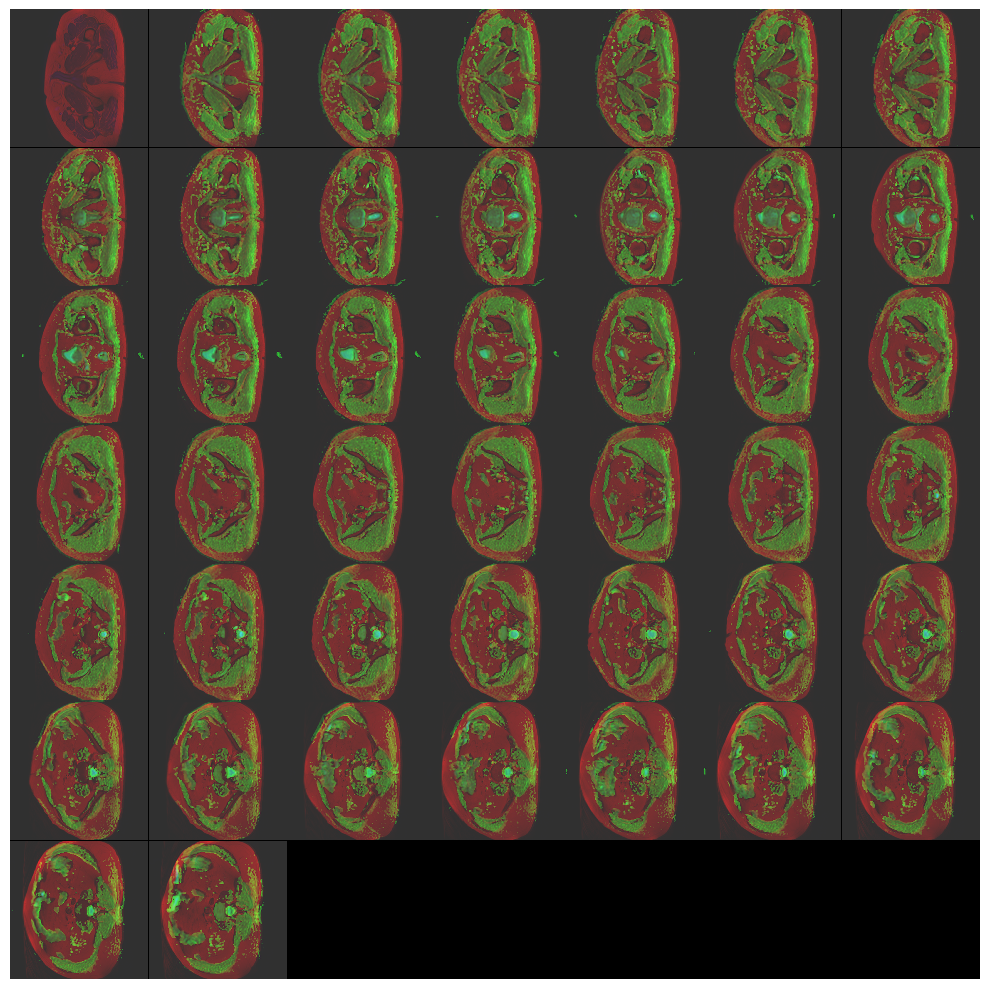

In [110]:
image = monai.transforms.ScaleIntensity()(image)
monai.visualize.matshow3d(image,channel_dim=0,frame_dim=-1,show=True)
plt.show()

In [13]:
import pandas as pd
import os

In [3]:
train = pd.read_csv("../Files/Own_data/Associated_Images_Training_Unified.csv")
validation = pd.read_csv("../Files/Own_data/Associated_Images_Validation_Unified.csv")

In [5]:
train["partition"] = "train"
validation["partition"] = "val"

In [ ]:
#Filter Table
path = "/mnt/ceib/datalake/FISABIO_datalake/prueba/p0052021_reborn"
derivatives_path = "/mnt/ceib/datalake/FISABIO_datalake/prueba/p0052021_reborn/derivatives/creating_adc"

train['Derivative'] = None

for i,row in train.iterrows():
    train['image_t2'][i] = os.path.join(path, row['subject'], row['session'],'mim-mr','anat', row['image_t2'])
    train['image_dwi'][i] = os.path.join(path, row['subject'], row['session'],'mim-mr','dwi', row['image_dwi'])

    adc_path = os.path.join(path, row['subject'], row['session'],'mim-mr','dwi', row['image_adc'])
    adc_path_derivative = os.path.join(derivatives_path, row['subject'], row['session'],'mim-mr','dwi', row['image_adc'])


    if os.path.exists(adc_path):
        train['Derivative'][i]=False
        train['image_adc'][i] = adc_path
    elif os.path.exists(adc_path_derivative):
        train['Derivative'][i]=True
        train['image_adc'][i] = adc_path_derivative

train_final_df = train[train['Derivative'] == False]

/tmp/ipykernel_199051/1311891940.py:8: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  train['image_t2'][i] = os.path.join(path, row['subject'], row['session'],'mim-mr','anat', row['image_t2'])
/tmp/ipykernel_199051/1311891940.py:8: SettingWit

In [14]:
train_final_df

,subject,session,image_t2,image_dwi,image_adc,dep,ED,AF,TB,TR,PSA,VP,PIR,csPC,F_nacimiento,F_RM,partition,Derivative
0,sub-002299,ses-002477,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,17.0,82.0,NaN,2.0,NaN,32.490,NaN,NaN,1.0,1935-05-07,2013-05-25,train,False
1,sub-002299,ses-002477,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,17.0,82.0,NaN,2.0,NaN,32.490,NaN,NaN,1.0,1935-05-07,2013-05-25,train,False
2,sub-002299,ses-002477,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,17.0,82.0,NaN,2.0,NaN,32.490,NaN,NaN,1.0,1935-05-07,2013-05-25,train,False
3,sub-002299,ses-004352,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,17.0,82.0,NaN,2.0,NaN,0.014,38.88404,NaN,1.0,1935-05-07,2014-12-25,train,False
4,sub-002299,ses-004352,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,17.0,82.0,NaN,2.0,NaN,0.014,38.88404,NaN,1.0,1935-05-07,2014-12-25,train,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4441,sub-001267,ses-001365,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,17.0,68.0,NaN,1.0,NaN,4.360,10.87320,NaN,1.0,1937-12-13,2006-08-27,train,False
4442,sub-001267,ses-001365,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,17.0,68.0,NaN,1.0,NaN,4.360,10.87320,NaN,1.0,1937-12-13,2006-08-27,train,False
4443,sub-001267,ses-001365,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,17.0,68.0,NaN,1.0,NaN,4.360,10.87320,NaN,1.0,1937-12-13,2006-08-27,train,False
4444,sub-001034,ses-001123,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,/mnt/ceib/datalake/FISABIO_datalake/prueba/p00...,17.0,68.0,11.0,1.0,NaN,12.900,28.17360,NaN,0.0,1945-04-19,2014-01-02,train,False


In [11]:
#Filter Table
path = "/mnt/ceib/datalake/FISABIO_datalake/prueba/p0042021"
derivatives_path = "/mnt/ceib/datalake/FISABIO_datalake/prueba/p0042021/derivatives/creating_adc"

validation['Derivative'] = None

for i,row in validation.iterrows():
    validation['image_t2'][i] = os.path.join(path, row['subject'], row['session'],'mim-mr','anat', row['image_t2'])
    validation['image_dwi'][i] = os.path.join(path, row['subject'], row['session'],'mim-mr','dwi', row['image_dwi'])

    adc_path = os.path.join(path, row['subject'], row['session'],'mim-mr','dwi', row['image_adc'])
    adc_path_derivative = os.path.join(derivatives_path, row['subject'], row['session'],'mim-mr','dwi', row['image_adc'])


    if os.path.exists(adc_path):
        validation['Derivative'][i]=False
        validation['image_adc'][i] = adc_path
    elif os.path.exists(adc_path_derivative):
        validation['Derivative'][i]=True
        validation['image_adc'][i] = adc_path_derivative

validation_final_df = validation[validation['Derivative'] == False]

/tmp/ipykernel_199051/1065928729.py:8: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  validation['image_t2'][i] = os.path.join(path, row['subject'], row['session'],'mim-mr','anat', row['image_t2'])
/tmp/ipykernel_199051/1065928729.py:8: Setti

In [15]:
pd.concat([train_final_df, validation_final_df]).to_csv("../Files/Own_data/Associated_Images_Unified.csv", index=False)